### Trying a new way to clean up the data

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import dandelion as ddl
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.logging.print_versions()

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/NC_study/scanpy'))

-----
anndata     0.7.4
scanpy      1.6.0
sinfo       0.3.1
-----
Bio                 1.77
PIL                 7.2.0
adjustText          NA
anndata             0.7.4
backcall            0.2.0
brotli              NA
cachecontrol        0.12.6
cairo               1.19.1
certifi             2020.06.20
cffi                1.14.1
changeo             1.0.0
chardet             3.0.4
cycler              0.10.0
cython_runtime      NA
dandelion           0.0.15
dateutil            2.8.0
decorator           4.4.2
descartes           NA
distance            NA
get_version         2.1
h5py                2.10.0
hdmedians           NA
idna                2.10
igraph              0.8.2
importlib_metadata  1.7.0
ipykernel           5.3.3
ipython_genutils    0.2.0
jedi                0.17.2
jinja2              2.11.2
joblib              0.16.0
kiwisolver          1.2.0
legacy_api_wrap     1.2
leidenalg           0.8.1
llvmlite            0.33.0
markupsafe          1.1.1
matplotlib          3.3.0
mizani 

In [2]:
# Set up the sample info
sampleInfo1 = pd.read_csv('/home/jovyan/NC_study/sampleInfo.csv')
sampleInfo2 = pd.read_csv('/home/jovyan/NC_study/sampleInfo_control.csv')

In [3]:
# download and read in the 10x 10k PBMC 5' dataset
adata_ref = sc.read_10x_h5('/home/jovyan/NC_study/datasets/sc5p_v2_hs_PBMC_10k_filtered_feature_bc_matrix.h5', gex_only=True)
adata_ref.obs_names_make_unique()
adata_ref.var_names_make_unique()
adata_ref.obs['cohort'] = '10x_10k'
adata_ref

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 10553 × 36601
    obs: 'cohort'
    var: 'gene_ids', 'feature_types', 'genome'

In [4]:
def geosketch_subsample(data, ncells):    
    from geosketch import gs
    from fbpca import pca

    # subsample adata to ncells with geosketch
    # Compute PCs.
    U, s, Vt = pca(data.X, k=100) # E.g., 100 PCs.
    X_dimred = U[:, :100] * s[:100]
    N = ncells # Number of samples to obtain from the data set.
    sketch_index = gs(X_dimred, N, replace=False)
    # now to subsample 
    data_ncells = data[sketch_index]
    return(data_ncells)

In [5]:
# read in black list of non-coding genes
blacklist = pd.read_csv('/home/jovyan/NC_study/datasets/NonProteinCodingGenes.txt')
blacklist = list(blacklist['gene_name'])

In [6]:
# read it as a list
adata_list = []
# for i in range(0, len(sampleInfo['10x_ID'])):
for i in sampleInfo1.index:            
    # import data
    inputfile='/home/jovyan/NC_study/raw/Trans/COVID/soupx/'+sampleInfo1['sampleid'].at[i]
    adata = sc.read_10x_mtx(inputfile, gex_only=True)
    # adata.var_names_make_unique()
    adata.obs['sampleid'] = sampleInfo1['sampleid'].at[i]
    adata.obs['patient'] = sampleInfo1['patient'].at[i]  
    adata.obs['sampletype'] = sampleInfo1['sampletype'].at[i]
    adata.obs['age_group'] = sampleInfo1['age_group'].at[i]
    adata.obs['gender'] = sampleInfo1['gender'].at[i]
    adata.obs['cohort'] = sampleInfo1['cohort'].at[i]
    # rename cells to sample id + barcode, cleaving the trailing -1
    adata.obs_names = [str(sampleInfo1['sampleid'].at[i])+'_'+str(j).split('-')[0] for j in adata.obs_names]
    adata.layers['counts'] = adata.X.copy()
    # using dandelion's qc recipe to mark doublets with scrublet and low quality cells based on standard metrics
    # default settings are max_genes=2500, min_genes=200, mito_cutoff=0.05, pval_cutoff=0.1, min_counts=None, max_counts=None, batch_term=None
    if adata.n_obs < (.95 * adata_ref.n_obs):
        data_r = geosketch_subsample(adata_ref, int(adata.n_obs))
    else:
        data_r = adata_ref.copy()
    adata2 = adata.concatenate(data_r)
    ddl.pp.recipe_scanpy_qc(adata2, max_genes=6000, mito_cutoff = 0.2, batch_term = 'cohort', blacklist = blacklist)    
    adata2 = adata2[~(adata2.obs['cohort'] == '10x_10k')]
    adata.obs = adata2.obs.copy()
    adata_list.append(adata)
for i in sampleInfo2.index:            
    # import data
    inputfile='/home/jovyan/NC_study/raw/Trans/COMBIVAS/soupx/'+sampleInfo2['sampleid'].at[i]
    adata = sc.read_10x_mtx(inputfile, gex_only=True)
    # adata.var_names_make_unique()
    adata.obs['sampleid'] = sampleInfo2['sampleid'].at[i]
    adata.obs['patient'] = sampleInfo2['patient'].at[i]    
    adata.obs['sampletype'] = sampleInfo2['sampletype'].at[i]
    adata.obs['age_group'] = sampleInfo2['age_group'].at[i]
    adata.obs['gender'] = sampleInfo2['gender'].at[i]
    adata.obs['cohort'] = sampleInfo2['cohort'].at[i]
    # rename cells to sample id + barcode, cleaving the trailing -1
    adata.obs_names = [str(sampleInfo2['sampleid'].at[i])+'_'+str(j).split('-')[0] for j in adata.obs_names]
    adata.layers['counts'] = adata.X.copy()
    # using dandelion's qc recipe to mark doublets with scrublet and low quality cells based on standard metrics
    # default settings are max_genes=2500, min_genes=200, mito_cutoff=0.05, pval_cutoff=0.1, min_counts=None, max_counts=None, batch_term=None
    if adata.n_obs < (.95 * adata_ref.n_obs):
        data_r = geosketch_subsample(adata_ref, int(adata.n_obs))
    else:
        data_r = adata_ref.copy()
    adata2 = adata.concatenate(data_r)
    ddl.pp.recipe_scanpy_qc(adata2, max_genes=6000, mito_cutoff = 0.2, batch_term = 'cohort', blacklist = blacklist)
    adata2 = adata2[~(adata2.obs['cohort'] == '10x_10k')]
    adata.obs = adata2.obs.copy()
    adata_list.append(adata)
adata = adata_list[0].concatenate(adata_list[1:], index_unique=None)
adata.obs['patient'] = adata.obs['patient'].astype('category')
adata

AnnData object with n_obs × n_vars = 100782 × 33538
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna'
    var: 'gene_ids', 'feature_types'
    layers: 'counts'

In [7]:
# How many cells are `bad quality`
pd.crosstab(adata.obs['filter_rna'], adata.obs['cohort'])

cohort,COVID,Healthy
filter_rna,,
False,28096,65875
True,1443,5368


In [8]:
# Remove the bad quality cells and continue
adata = adata[adata.obs['filter_rna'] != True]
adata

View of AnnData object with n_obs × n_vars = 93971 × 33538
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna'
    var: 'gene_ids', 'feature_types'
    layers: 'counts'

In [9]:
# check how many cells
pd.crosstab(adata.obs['sampletype'], adata.obs['patient'])

patient,1.0,2.0,3.0,C17,C19,C20,C21,C24,C26
sampletype,,,,,,,,,
Blood,1657,6832,8894,6065,7353,5862,5173,4171,0
Nasal,2422,1917,6374,14892,9501,1877,4855,1974,4152


In [10]:
# filter genes
sc.pp.filter_genes(adata, min_cells = 3)
# create a separate object to hold the raw counts
adata_raw = adata.copy()
# also do this
adata.layers["counts"] = adata.X.copy()
adata_raw.layers["counts"] = adata_raw.X.copy()

Trying to set attribute `.var` of view, copying.


... storing 'sampleid' as categorical
... storing 'sampletype' as categorical
... storing 'age_group' as categorical
... storing 'gender' as categorical
... storing 'cohort' as categorical
... storing 'is_doublet' as categorical
... storing 'feature_types' as categorical


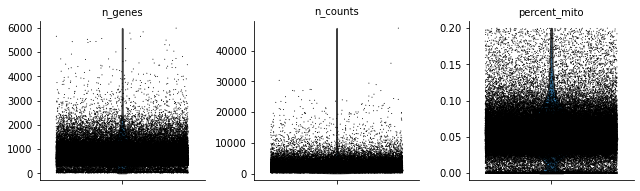

In [11]:
# violin plot of the computed quality measures.
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'], jitter = 0.4, multi_panel = True)

In [12]:
# normalize to 10000 counts per cell
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)
# stash the normalized data in raw
adata.raw = adata
adata

AnnData object with n_obs × n_vars = 93971 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna'
    var: 'gene_ids', 'feature_types', 'n_cells'
    uns: 'log1p'
    layers: 'counts'

In [13]:
# adata = adata.raw.to_adata()
# adata.raw = adata

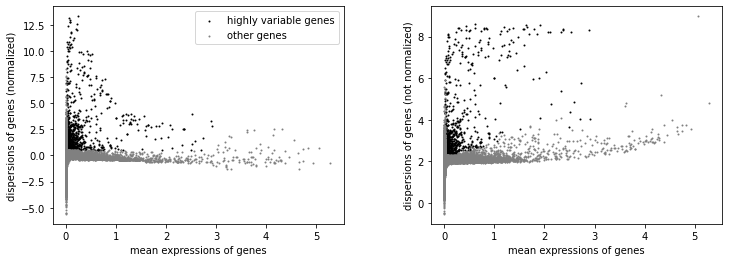

In [14]:
# Identify highly-variable genes
sc.pp.highly_variable_genes(adata, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
# plot highly_variable_genes
sc.pl.highly_variable_genes(adata)

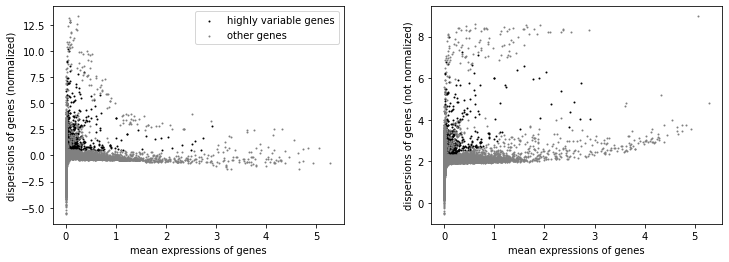

In [15]:
## remove VDJ genes from TRA/TRB and IGH/K/L from the highly variable genes
import re
for i in adata.var.index:
    if re.search('^TR[AB][VDJ]|^IG[HKL][VDJ]', i):
        adata.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(adata)

In [16]:
# filter to only highly variable
adata = adata[:, adata.var['highly_variable']]
adata

View of AnnData object with n_obs × n_vars = 93971 × 876
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'
    layers: 'counts'

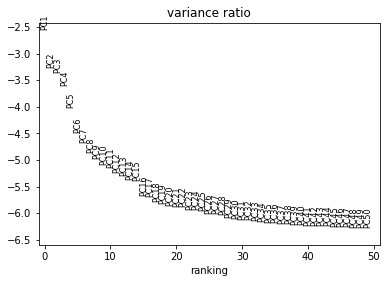

In [17]:
import multiprocessing
# regress and scale for PCA
sc.pp.regress_out(adata, ['n_counts', 'percent_mito'], n_jobs = multiprocessing.cpu_count()-4)
sc.pp.scale(adata, max_value = 10)
# Principal component analysis
sc.tl.pca(adata, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(adata, log = True, n_pcs = 50)

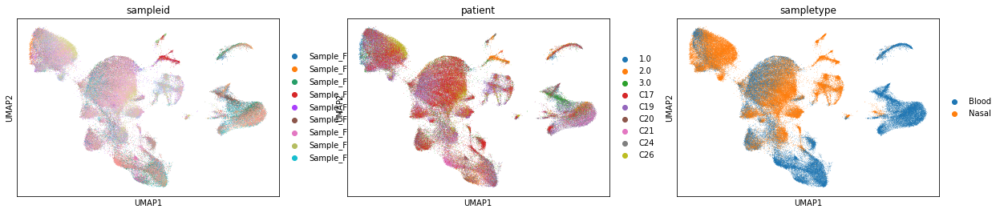

In [18]:
# run BBKNN
sc.external.pp.bbknn(adata, batch_key = 'patient')
# UMAP
sc.tl.umap(adata, n_components = 2, min_dist = 0.3)
sc.pl.umap(adata, color=['sampleid', 'patient', 'sampletype'])

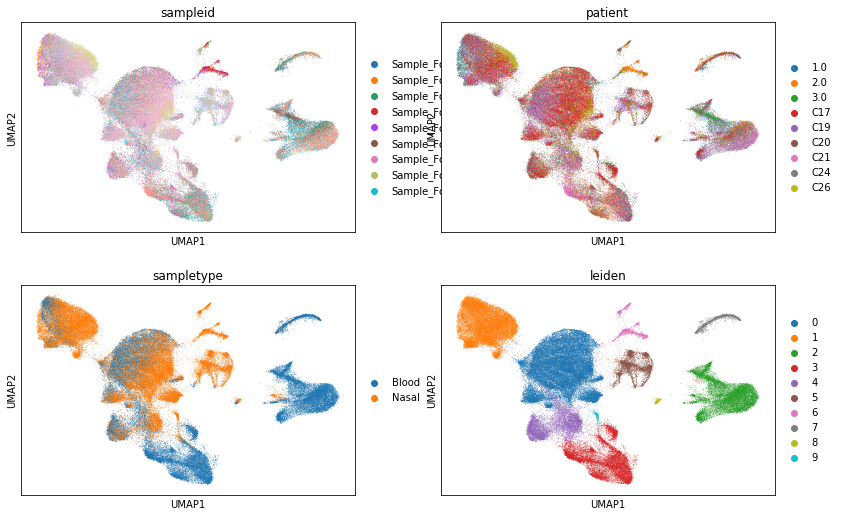

In [19]:
# find clusters
sc.tl.leiden(adata, resolution = 0.3)
sc.pl.umap(adata, color=['sampleid', 'patient', 'sampletype', 'leiden'], ncols = 2)

In [20]:
# create a palette for umap
import sys
sys.path.append('/home/jovyan/NC_study/scanpy/scripts')
from tools import cmp
newcmp = cmp()

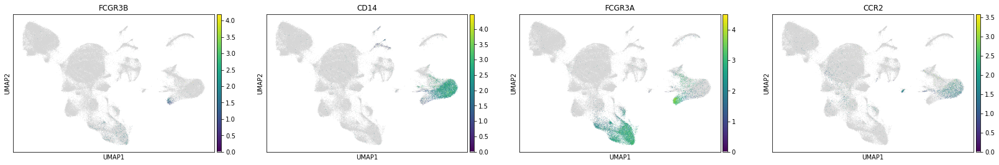

In [21]:
sc.pl.umap(adata, color = ['FCGR3B', 'CD14', 'FCGR3A', 'CCR2'], color_map = newcmp)

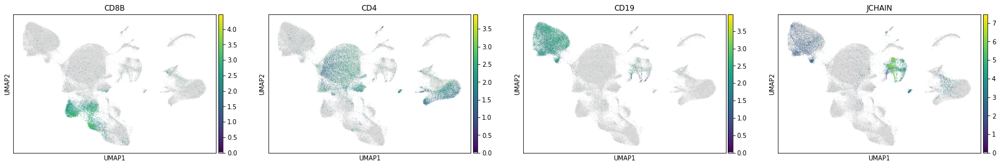

In [22]:
sc.pl.umap(adata, color = ['CD8B', 'CD4', 'CD19', 'JCHAIN'], color_map = newcmp)

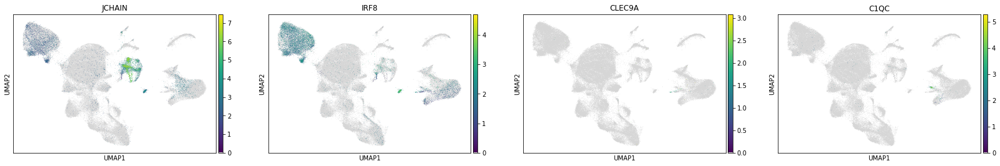

In [23]:
sc.pl.umap(adata, color = ['JCHAIN', 'IRF8', 'CLEC9A', 'C1QC'], color_map = newcmp)

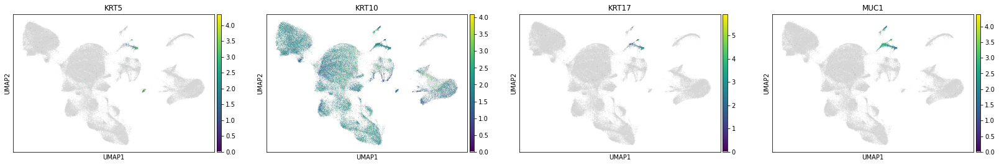

In [24]:
sc.pl.umap(adata, color = ['KRT5', 'KRT10', 'KRT17', 'MUC1'], color_map = newcmp)

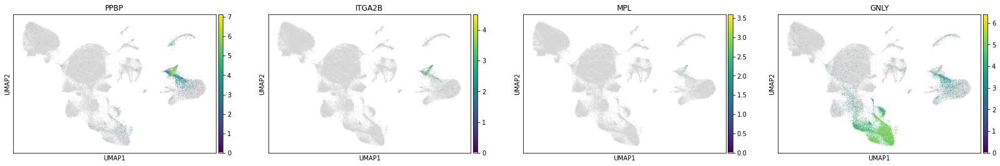

In [25]:
sc.pl.umap(adata, color = ['PPBP', 'ITGA2B', 'MPL', 'GNLY'], color_map = newcmp)

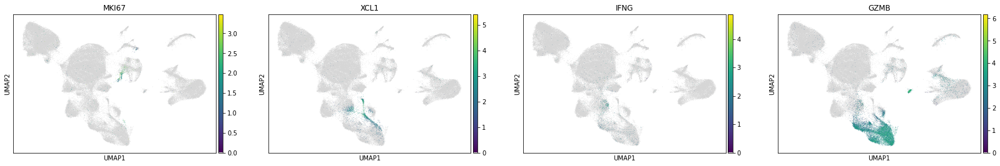

In [26]:
sc.pl.umap(adata, color = ['MKI67', 'XCL1', 'IFNG', 'GZMB'], color_map = newcmp)

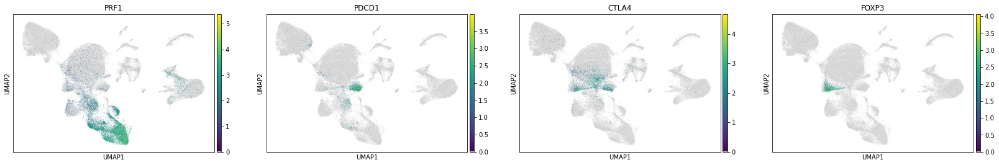

In [27]:
sc.pl.umap(adata, color = ['PRF1', 'PDCD1', 'CTLA4', 'FOXP3'], color_map = newcmp)

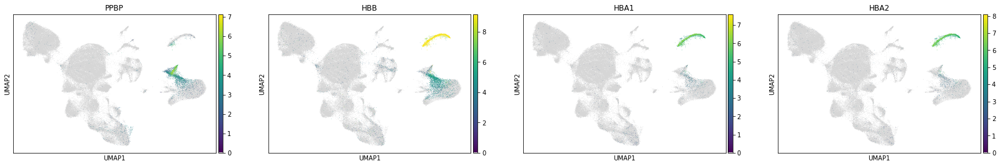

In [28]:
sc.pl.umap(adata, color = ['PPBP', 'HBB', 'HBA1', 'HBA2'], color_map = newcmp)

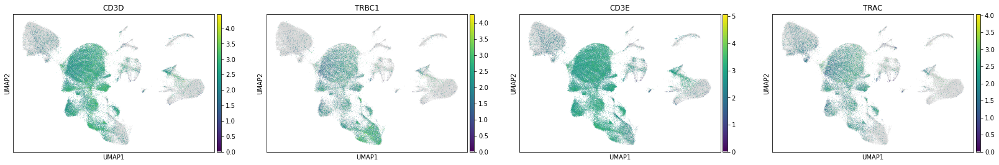

In [29]:
sc.pl.umap(adata, color = ['CD3D', 'TRBC1', 'CD3E', 'TRAC'], color_map = newcmp)

In [30]:
# save the file temporarily
adata_raw.obs = adata.obs.copy() 
adata.write('out/adata_combined_v2.h5ad', compression = 'gzip')
adata_raw.write('out/adata_combined_raw_v2.h5ad', compression = 'gzip')

... storing 'feature_types' as categorical


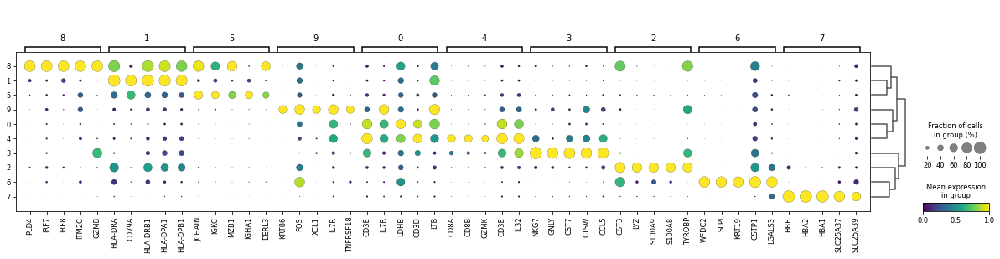

In [31]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(adata, min_fold_change=1)
sc.tl.dendrogram(adata, groupby = 'leiden')
sc.pl.rank_genes_groups_dotplot(adata, n_genes = 5, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import dandelion as ddl
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.logging.print_header()

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/NC_study/scanpy'))

scanpy==1.6.0 anndata==0.7.4 umap==0.4.6 numpy==1.19.1 scipy==1.5.2 pandas==1.0.5 scikit-learn==0.23.1 statsmodels==0.11.1 python-igraph==0.8.2 leidenalg==0.8.1


In [3]:
adata = sc.read_h5ad('out/adata_combined_v2.h5ad')
adata_raw = sc.read_h5ad('out/adata_combined_raw_v2.h5ad')

### Check cluster positions again

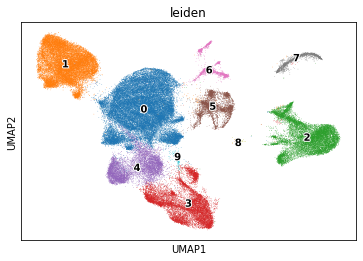

In [4]:
sc.pl.umap(adata, color = ['leiden'], legend_loc = 'on data', legend_fontoutline=2)

## Sub-clustering for fine cell type annotation

First create a new column called `temp_label` which I will update as I progress through.

In [5]:
adata.obs['temp_label'] = adata.obs['leiden']

### MNP clean up: Round one

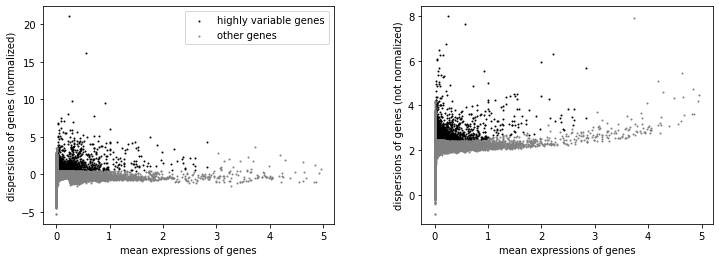

AnnData object with n_obs × n_vars = 12819 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap'
    obsm: 'X_pca', 'X_umap'

In [6]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['2'])]
rna_x = rna_.raw.to_adata()
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [7]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

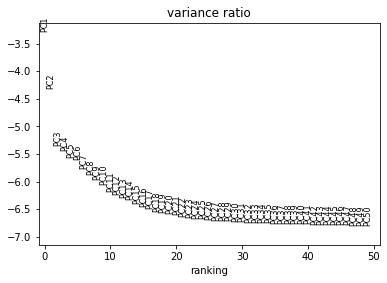

In [8]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

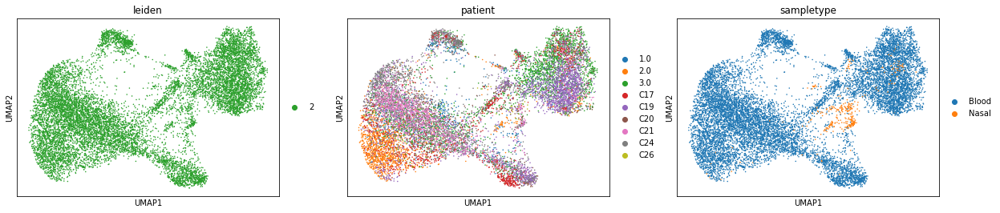

In [9]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient')
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'])

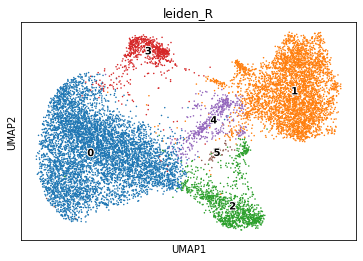

In [10]:
# find clusters
sc.tl.leiden(rna_x, resolution = .5, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden_R'], legend_loc ='on data', legend_fontoutline=2)

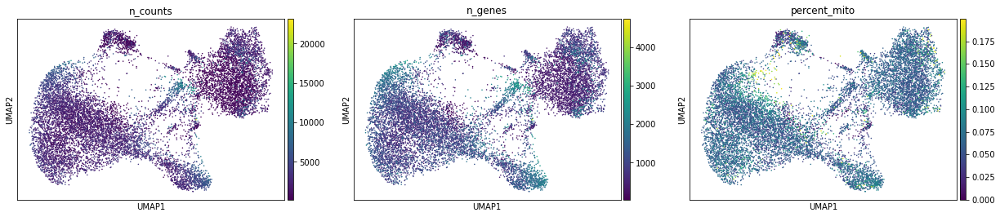

In [11]:
sc.pl.umap(rna_x, color=['n_counts', 'n_genes', 'percent_mito'])

In [12]:
# create a palette for umap
import sys
sys.path.append('/home/jovyan/NC_study/scanpy/scripts')
from tools import cmp
newcmp = cmp()

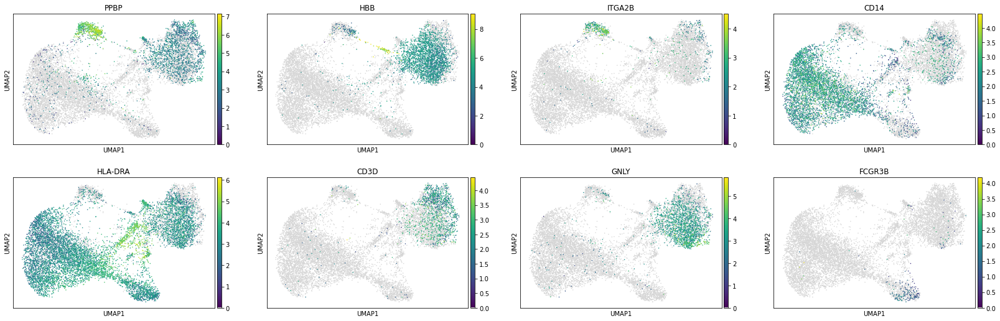

In [13]:
sc.pl.umap(rna_x, color = ['PPBP', 'HBB', 'ITGA2B', 'CD14', 'HLA-DRA', 'CD3D', 'GNLY', 'FCGR3B'], color_map = newcmp)

... storing 'temp_label' as categorical


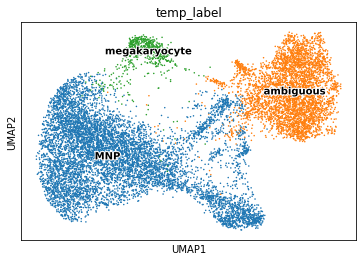

In [14]:
new_dict1 = {'0':'MNP',
             '1':'ambiguous',
             '2':'MNP',
             '3':'megakaryocyte',
             '4':'MNP',
             '5':'MNP'}
rna_x.obs['temp_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['temp_label'], legend_loc ='on data', legend_fontoutline=2)

... storing 'temp_label' as categorical


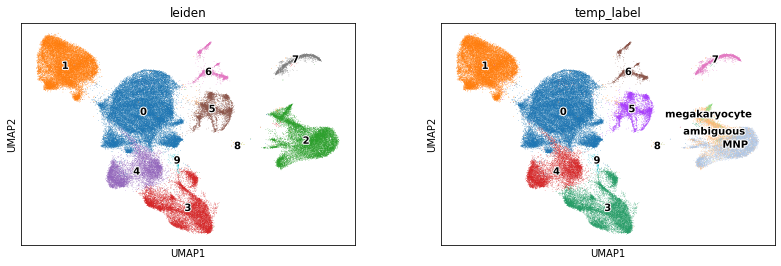

In [15]:
# update the original object
adata.obs['temp_label'] = adata.obs['temp_label'].astype('object')
adata.obs['temp_label'].update(rna_x.obs['temp_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'temp_label'], legend_loc = 'on data', legend_fontoutline=2)

### MNP clean up: Round two

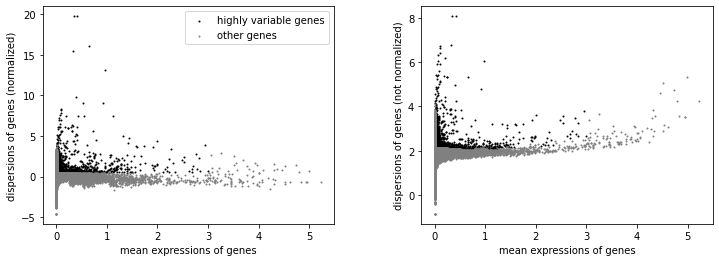

AnnData object with n_obs × n_vars = 8025 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label', 'leiden_R'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap', 'leiden_R_colors', 'temp_label_colors'
    obsm: 'X_pca', 'X_umap'

In [16]:
# subset
rna_ = rna_x[~(rna_x.obs['temp_label'].isin(['ambiguous', 'megakaryocyte']))]
rna_x = rna_.raw.to_adata()
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [17]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

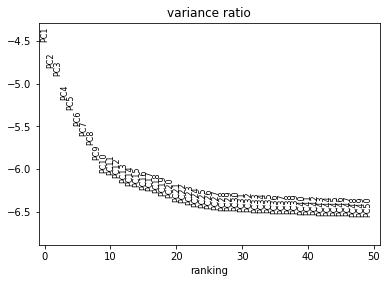

In [18]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

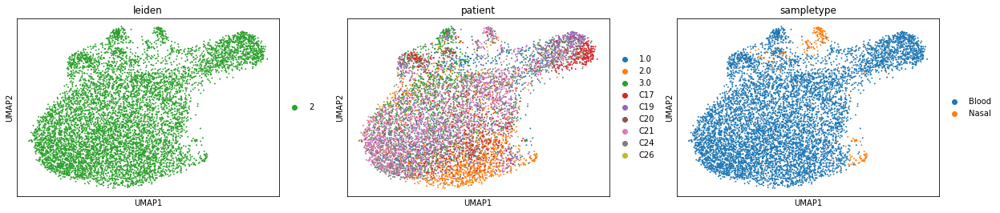

In [19]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient')
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'])

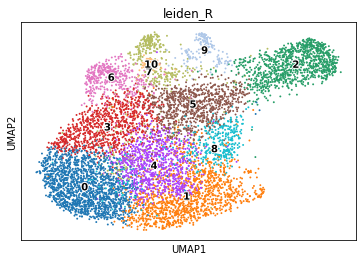

In [20]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden_R'], legend_loc ='on data', legend_fontoutline=2)

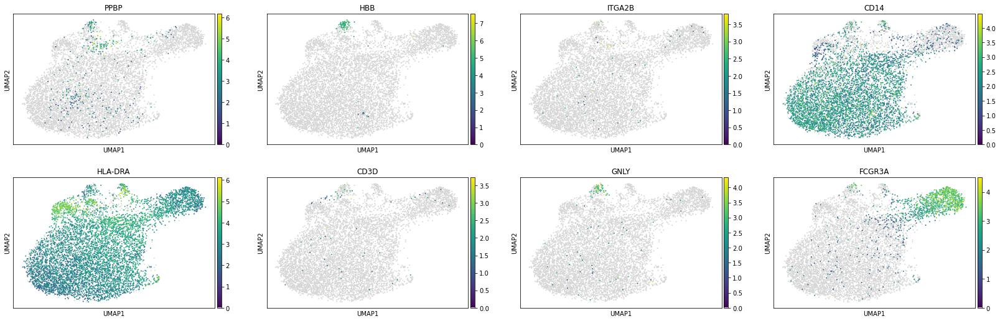

In [21]:
sc.pl.umap(rna_x, color = ['PPBP', 'HBB', 'ITGA2B', 'CD14', 'HLA-DRA', 'CD3D', 'GNLY', 'FCGR3A'], color_map = newcmp)

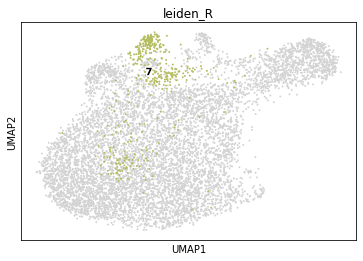

In [22]:
sc.pl.umap(rna_x, color=['leiden_R'], groups = '7', legend_loc ='on data', legend_fontoutline=2)

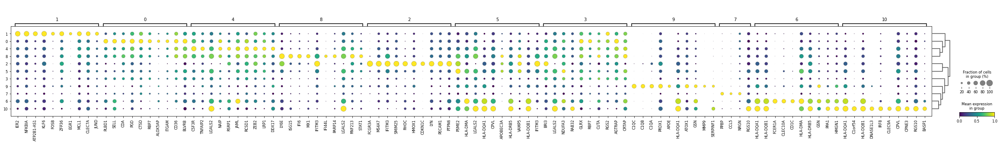

In [23]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'temp_label' as categorical


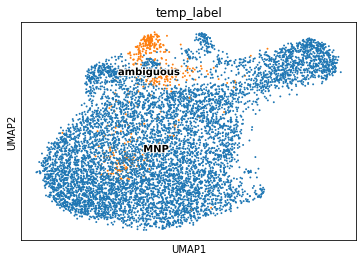

In [24]:
new_dict1 = {'0':'MNP',
             '1':'MNP',
             '2':'MNP',
             '3':'MNP',
             '4':'MNP',
             '5':'MNP',
             '6':'MNP',
             '7':'ambiguous',
             '8':'MNP',
             '9':'MNP',
             '10':'MNP'}
rna_x.obs['temp_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['temp_label'], legend_loc ='on data', legend_fontoutline=2)

... storing 'temp_label' as categorical


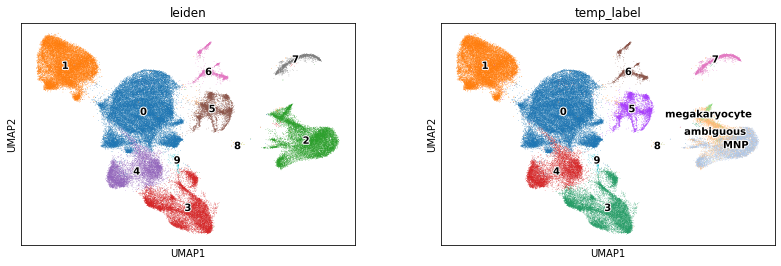

In [25]:
# update the original object
adata.obs['temp_label'] = adata.obs['temp_label'].astype('object')
adata.obs['temp_label'].update(rna_x.obs['temp_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'temp_label'], legend_loc = 'on data', legend_fontoutline=2)

### MNP clean up: Round three

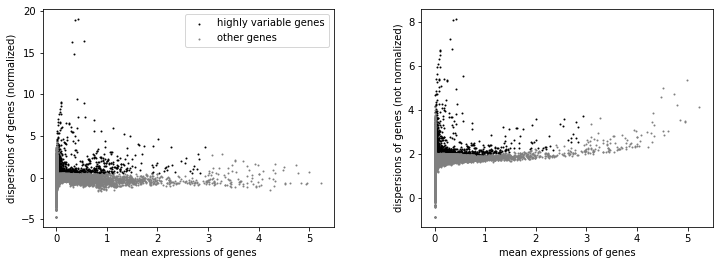

AnnData object with n_obs × n_vars = 7587 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label', 'leiden_R', '__is_in_cluster__'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap', 'leiden_R_colors', 'temp_label_colors', 'rank_genes_groups', 'rank_genes_groups_filtered', "dendrogram_['leiden_R']"
    obsm: 'X_pca', 'X_umap'

In [26]:
# subset
rna_ = rna_x[~(rna_x.obs['temp_label'].isin(['ambiguous']))]
rna_x = rna_.raw.to_adata()
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [27]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

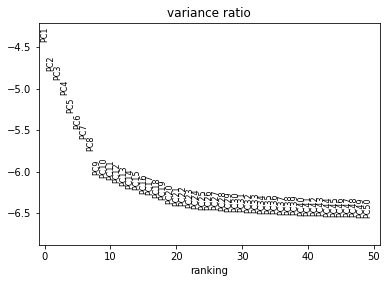

In [28]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

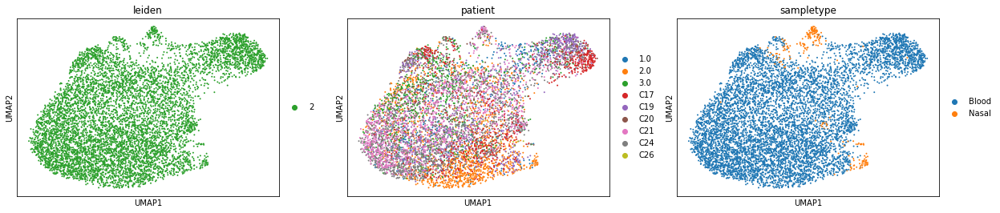

In [29]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient')
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'])

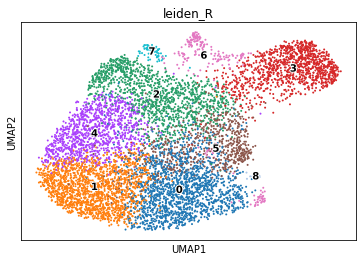

In [30]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden_R'], legend_loc ='on data', legend_fontoutline=2)

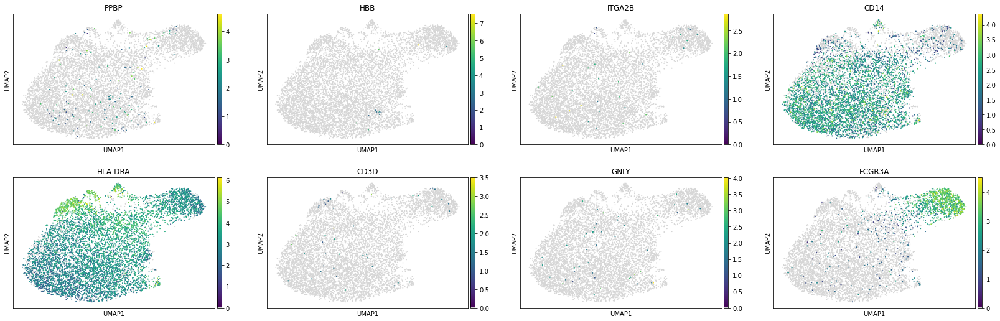

In [31]:
sc.pl.umap(rna_x, color = ['PPBP', 'HBB', 'ITGA2B', 'CD14', 'HLA-DRA', 'CD3D', 'GNLY', 'FCGR3A'], color_map = newcmp)

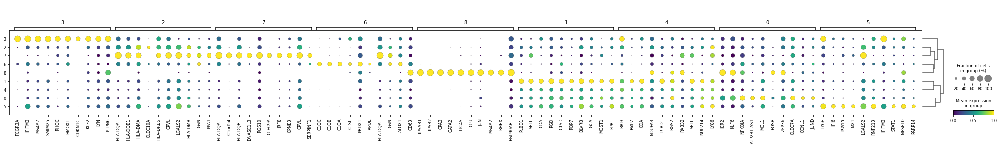

In [32]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'temp_label' as categorical


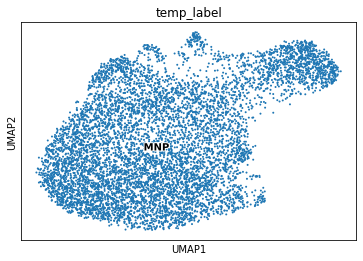

In [33]:
new_dict1 = {'0':'MNP',
             '1':'MNP',
             '2':'MNP',
             '3':'MNP',
             '4':'MNP',
             '5':'MNP',
             '6':'MNP',
             '7':'MNP',
             '8':'MNP'}
rna_x.obs['temp_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['temp_label'], legend_loc ='on data', legend_fontoutline=2)

### Erythrocyte

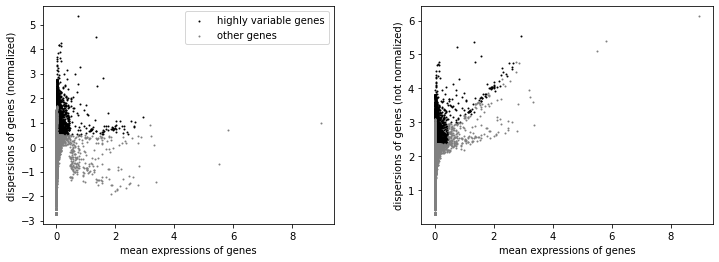

AnnData object with n_obs × n_vars = 1781 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap', 'temp_label_colors'
    obsm: 'X_pca', 'X_umap'

In [34]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['7'])]
rna_x = rna_.raw.to_adata()
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [35]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

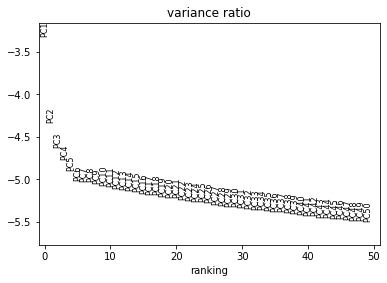

In [36]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

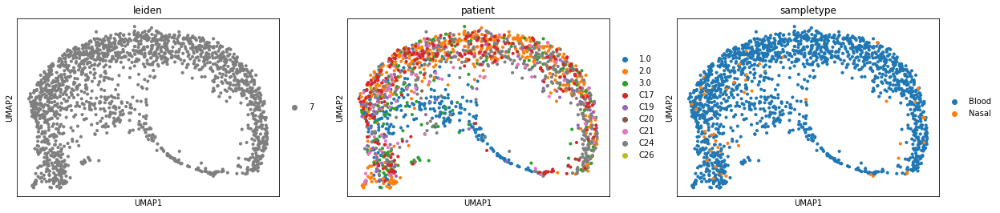

In [37]:
# run BBKNN
sc.pp.neighbors(rna_x)
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'])

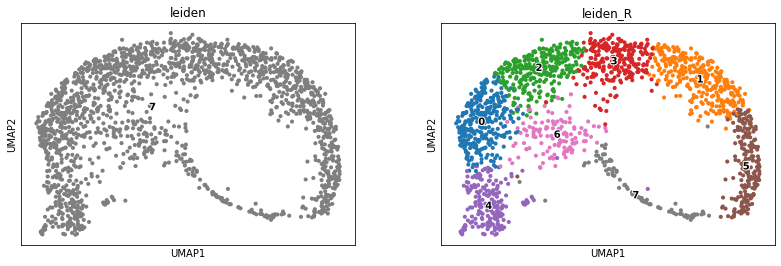

In [38]:
# find clusters
sc.tl.leiden(rna_x, resolution = 1.2, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], legend_loc ='on data', legend_fontoutline=2)

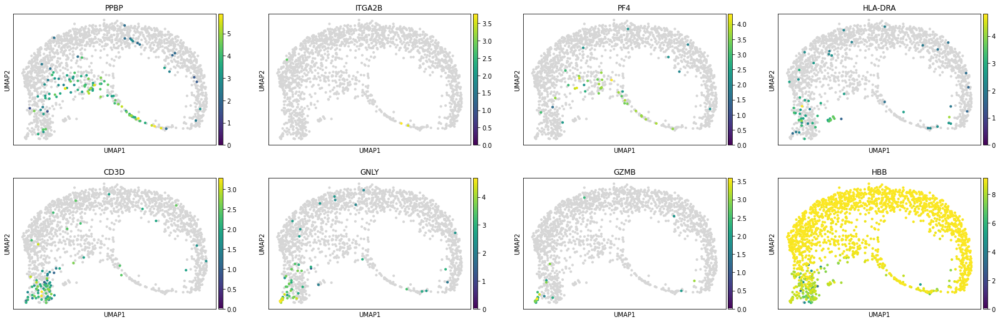

In [39]:
sc.pl.umap(rna_x, color = ['PPBP', 'ITGA2B', 'PF4', 'HLA-DRA', 'CD3D', 'GNLY', 'GZMB', 'HBB'], color_map = newcmp)

categories: 0, 1, 2, etc.
var_group_labels: 1, 2, 3, etc.


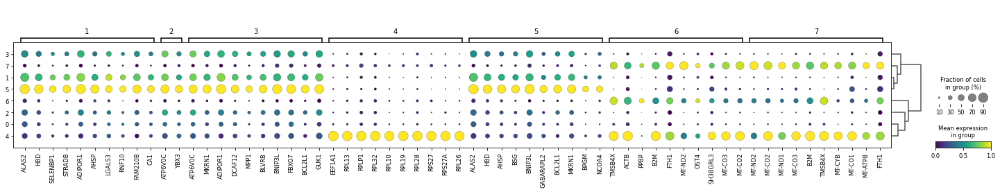

In [40]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'temp_label' as categorical


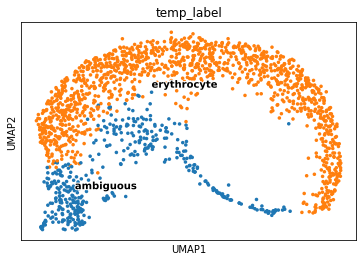

In [41]:
new_dict1 = {'0':'erythrocyte',
'1':'erythrocyte',
'2':'erythrocyte',
'3':'erythrocyte',
'4':'ambiguous',
'5':'erythrocyte',
'6':'ambiguous',
'7':'ambiguous'}
rna_x.obs['temp_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['temp_label'], size=50, legend_loc ='on data', legend_fontoutline=2)

... storing 'temp_label' as categorical


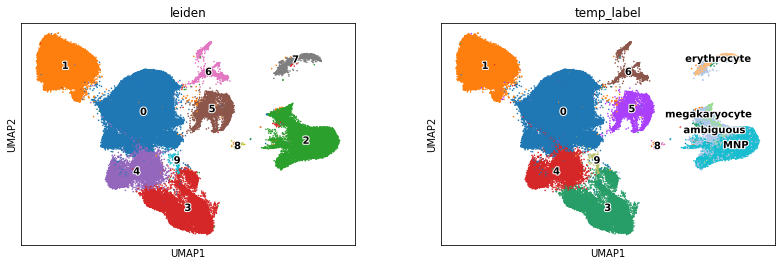

In [42]:
# update the original object
adata.obs['temp_label'] = adata.obs['temp_label'].astype('object')
adata.obs['temp_label'].update(rna_x.obs['temp_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'temp_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### NK cell/T cell

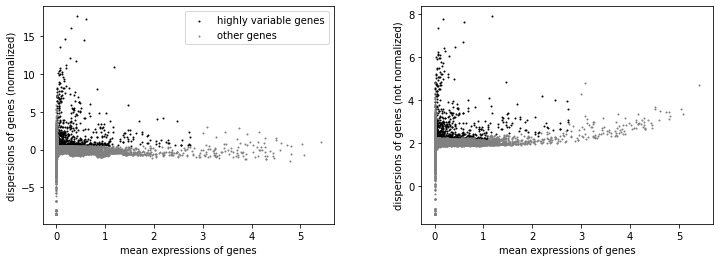

AnnData object with n_obs × n_vars = 52781 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap', 'temp_label_colors'
    obsm: 'X_pca', 'X_umap'

In [43]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['0','3','4','9'])]
rna_x = rna_.raw.to_adata()
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [44]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

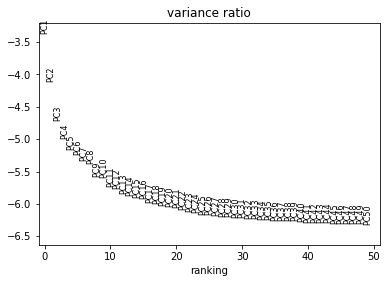

In [45]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

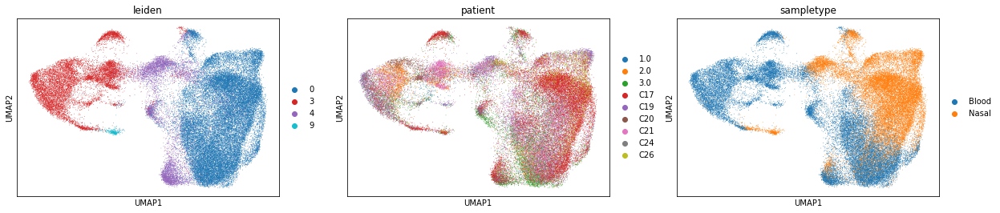

In [46]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient')
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'])

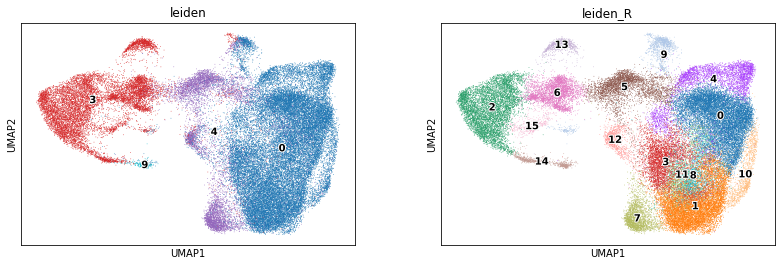

In [47]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], legend_loc ='on data', legend_fontoutline=2)

In [48]:
rna_x

AnnData object with n_obs × n_vars = 52781 × 856
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label', 'leiden_R'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap', 'temp_label_colors', 'leiden_R_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

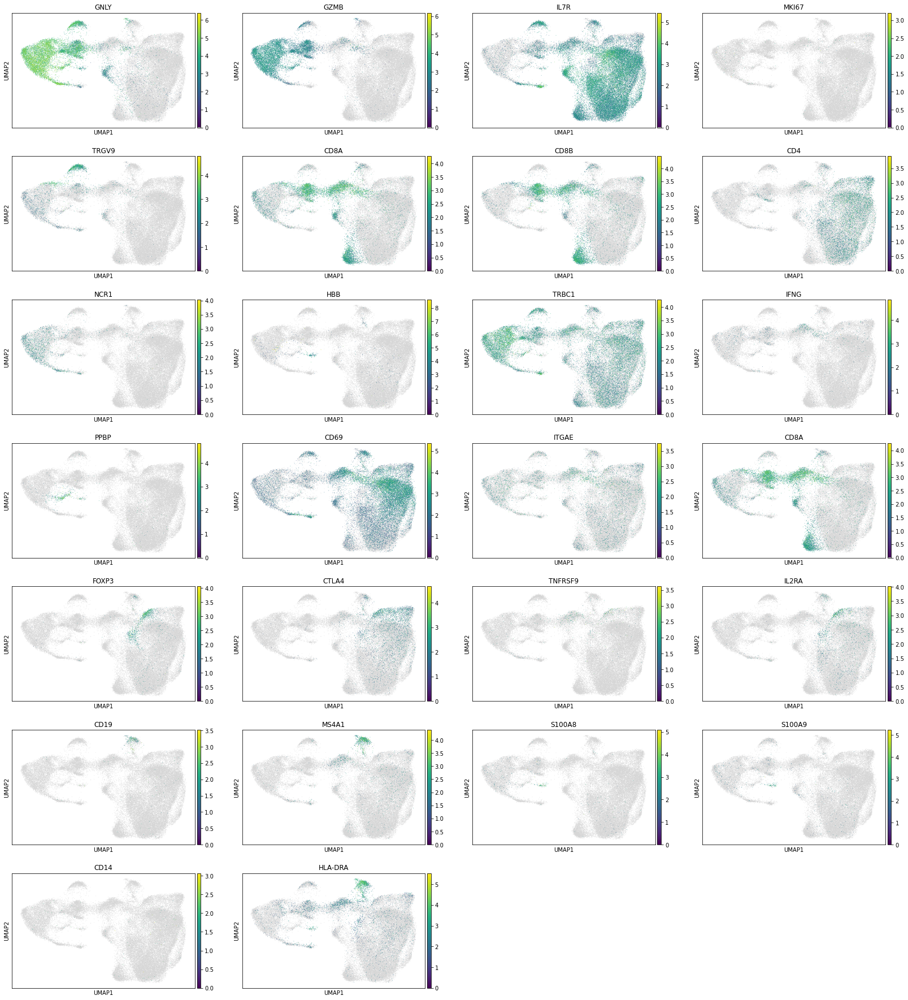

In [49]:
sc.pl.umap(rna_x, color = ['GNLY', 'GZMB', 'IL7R', 'MKI67', 'TRGV9', 'CD8A', 'CD8B', 'CD4', 'NCR1', 'HBB', 'TRBC1', 'IFNG','PPBP', 'CD69', 'ITGAE', 'CD8A', 'FOXP3', 'CTLA4', 'TNFRSF9', 'IL2RA', 'CD19', 'MS4A1', 'S100A8', 'S100A9', 'CD14', 'HLA-DRA'], color_map = newcmp)

... storing 'temp_label' as categorical


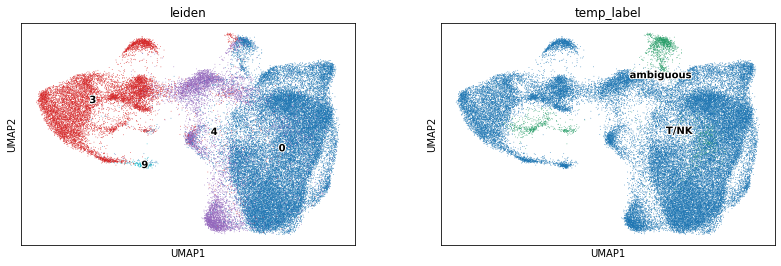

In [50]:
new_dict1 = {'0':'T/NK',
'1':'T/NK',
'2':'T/NK',
'3':'T/NK',
'4':'T/NK',
'5':'T/NK',
'6':'T/NK',
'7':'T/NK',
'8':'T/NK',
'9':'ambiguous',
'10':'T/NK',
'11':'T/NK',
'12':'T/NK',
'13':'T/NK',
'14':'T/NK',
'15':'ambiguous'}
rna_x.obs['temp_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['leiden', 'temp_label'], legend_loc ='on data', legend_fontoutline=2)

... storing 'temp_label' as categorical


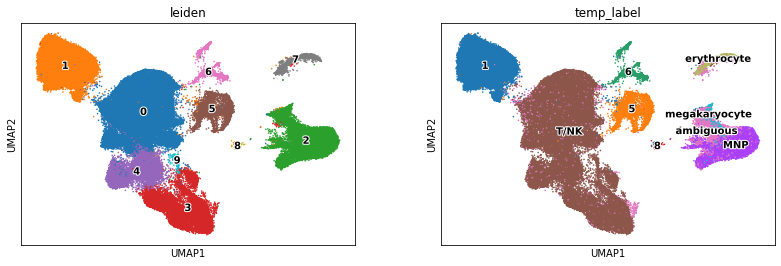

In [51]:
# update the original object
adata.obs['temp_label'] = adata.obs['temp_label'].astype('object')
adata.obs['temp_label'].update(rna_x.obs['temp_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'temp_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [71]:
# save the file temporarily
adata_raw.obs = adata.obs.copy() 
adata.write('out/adata_combined_v2.h5ad', compression = 'gzip')
adata_raw.write('out/adata_combined_raw_v2.h5ad', compression = 'gzip')

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import dandelion as ddl
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.logging.print_header()

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/NC_study/scanpy'))

# create a palette for umap
import sys
sys.path.append('/home/jovyan/NC_study/scanpy/scripts')
from tools import cmp
newcmp = cmp()

scanpy==1.6.0 anndata==0.7.4 umap==0.4.6 numpy==1.19.1 scipy==1.5.2 pandas==1.0.5 scikit-learn==0.23.1 statsmodels==0.11.1 python-igraph==0.8.2 leidenalg==0.8.1


In [2]:
adata = sc.read_h5ad('out/adata_combined_v2.h5ad')
adata_raw = sc.read_h5ad('out/adata_combined_raw_v2.h5ad')

### T/NK clean up: Round two

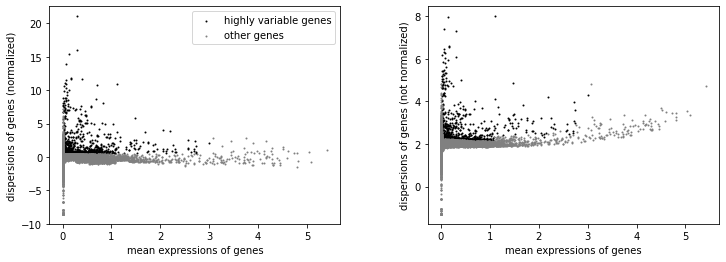

AnnData object with n_obs × n_vars = 50719 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap'
    obsm: 'X_pca', 'X_umap'

In [3]:
# subset
rna_ = adata[(adata.obs['temp_label'].isin(['T/NK']))]
rna_x = rna_.raw.to_adata()
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [4]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

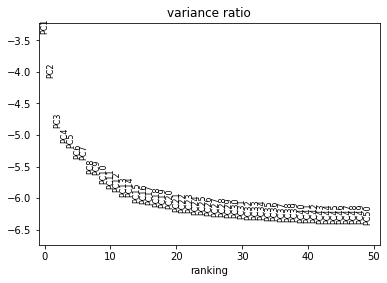

In [5]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

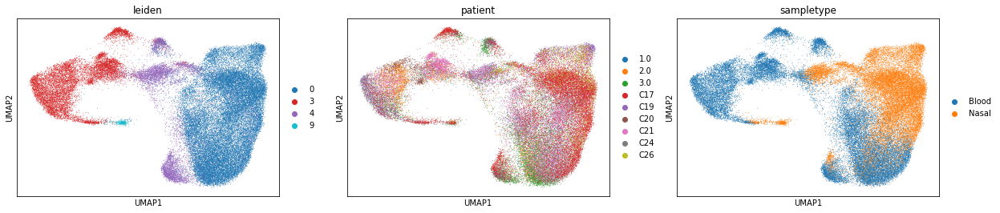

In [6]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient')
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'])

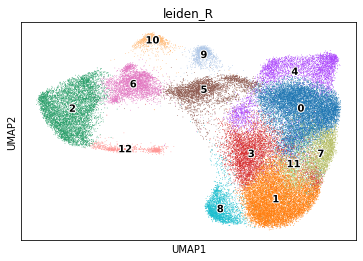

In [7]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden_R'], legend_loc ='on data', legend_fontoutline=2)

### CD4

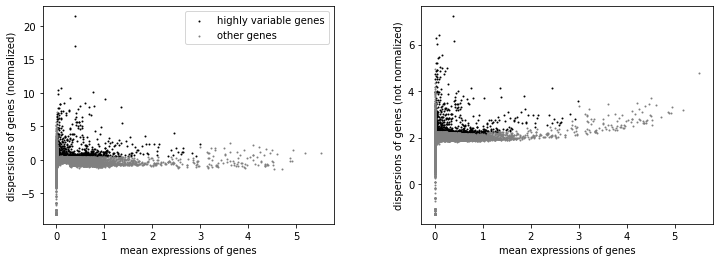

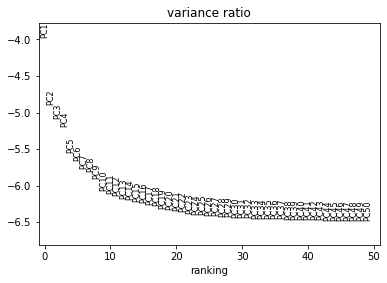

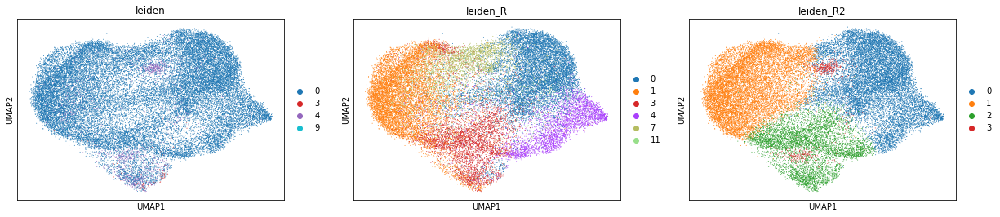

In [8]:
# subset to CD4
adatax_cd4 = rna_x[rna_x.obs['leiden_R'].isin(['0','1','3','4', '7','11'])]
adatax_cd4 = adatax_cd4.raw.to_adata()
adatax_cd4.raw = adatax_cd4
sc.pp.highly_variable_genes(adatax_cd4, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(adatax_cd4)
# subset to highly variable
adatax_cd4 = adatax_cd4[:, adatax_cd4.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(adatax_cd4, ['n_counts', 'percent_mito'])
sc.pp.scale(adatax_cd4, max_value = 10)
# Principal component analysis
sc.tl.pca(adatax_cd4, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(adatax_cd4, log = True, n_pcs = 50)
# run BBKNN
sc.external.pp.bbknn(adatax_cd4, batch_key = 'patient')
# UMAP
sc.tl.umap(adatax_cd4, n_components = 2, min_dist = 0.3)
sc.tl.leiden(adatax_cd4, resolution = 0.5, key_added = 'leiden_R2')
sc.pl.umap(adatax_cd4, color=['leiden', 'leiden_R', 'leiden_R2'])

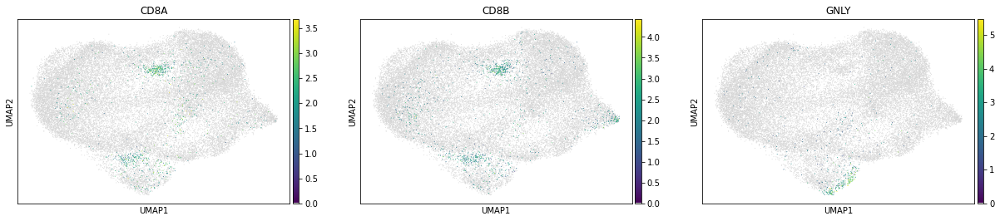

In [9]:
sc.pl.umap(adatax_cd4, color = ['CD8A', 'CD8B', 'GNLY'], color_map = newcmp)

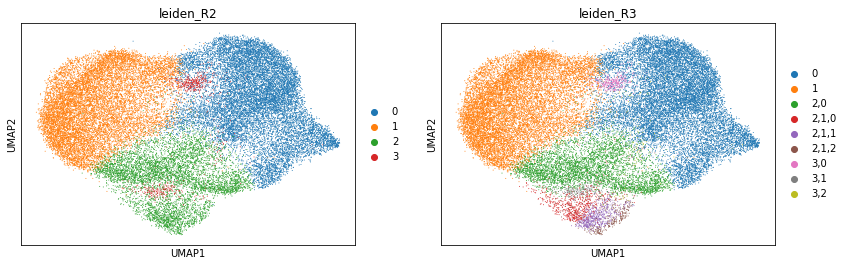

In [19]:
sc.tl.leiden(adatax_cd4, resolution = .5, key_added = 'leiden_R3', restrict_to = ('leiden_R2', ['3']))
sc.tl.leiden(adatax_cd4, resolution = .2, key_added = 'leiden_R3', restrict_to = ('leiden_R3', ['2']))
sc.tl.leiden(adatax_cd4, resolution = .5, key_added = 'leiden_R3', restrict_to = ('leiden_R3', ['2,1']))
sc.pl.umap(adatax_cd4, color=['leiden_R2', 'leiden_R3'])

In [22]:
sc.tl.rank_genes_groups(adatax_cd4, groupby = 'leiden_R3', method = 'wilcoxon')

In [23]:
# sc.tl.filter_rank_genes_groups(adatax_cd4, min_fold_change=1)

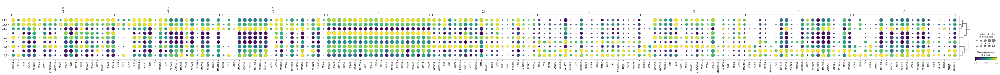

In [25]:
sc.pl.rank_genes_groups_dotplot(adatax_cd4, n_genes = 20, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups')

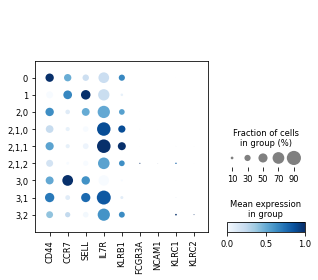

In [36]:
sc.pl.DotPlot(adatax_cd4, ['CD44', 'CCR7', 'SELL', 'IL7R', 'KLRB1', 'FCGR3A', 'NCAM1', 'KLRC1', 'KLRC2'], groupby = 'leiden_R3', standard_scale = 'var').style(cmap = 'Blues', dot_edge_lw = 0).show()

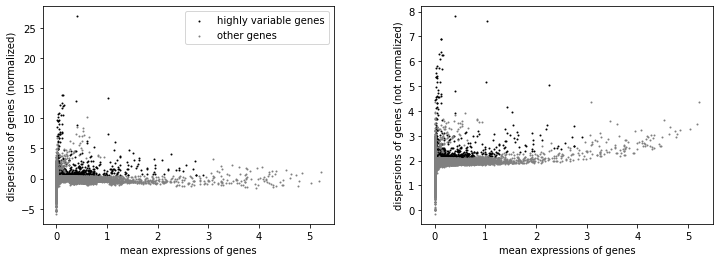

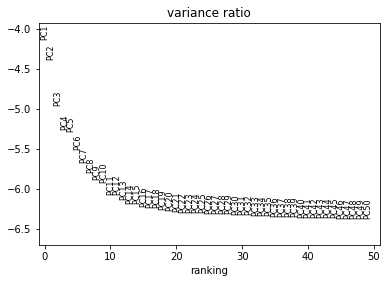

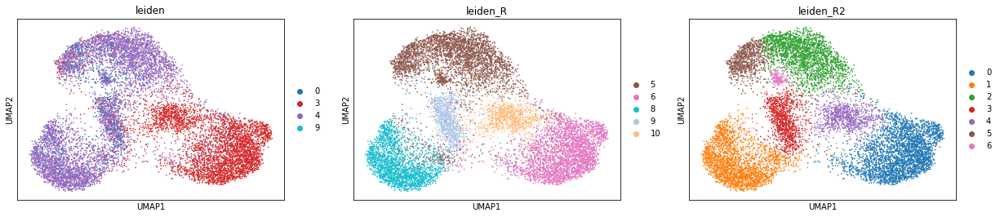

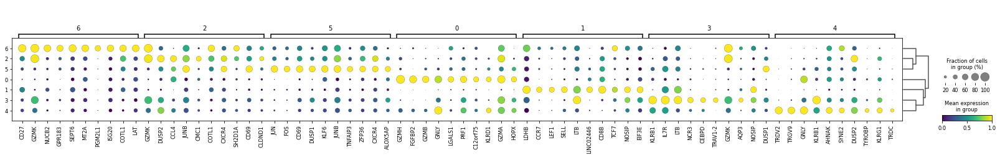

In [40]:
# subset to CD8
adatax_cd8 = rna_x[rna_x.obs['leiden_R'].isin(['6','5','8', '9','10'])]
adatax_cd8 = adatax_cd8.raw.to_adata()
adatax_cd8.raw = adatax_cd8
sc.pp.highly_variable_genes(adatax_cd8, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
import re
for i in adatax_cd8.var.index:
    if re.search('^TR[AB][VDJ]', i):
        adatax_cd8.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(adatax_cd8)
# subset to highly variable
adatax_cd8 = adatax_cd8[:, adatax_cd8.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(adatax_cd8, ['n_counts', 'percent_mito'])
sc.pp.scale(adatax_cd8, max_value = 10)
# Principal component analysis
sc.tl.pca(adatax_cd8, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(adatax_cd8, log = True, n_pcs = 50)
# run BBKNN
sc.external.pp.bbknn(adatax_cd8, batch_key = 'patient')
# UMAP
sc.tl.umap(adatax_cd8, n_components = 2, min_dist = 0.3)
sc.tl.leiden(adatax_cd8, resolution = 1, key_added = 'leiden_R2')
sc.pl.umap(adatax_cd8, color=['leiden', 'leiden_R', 'leiden_R2'])
sc.tl.rank_genes_groups(adatax_cd8, groupby = 'leiden_R2', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(adatax_cd8, min_fold_change=1)
sc.pl.rank_genes_groups_dotplot(adatax_cd8, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

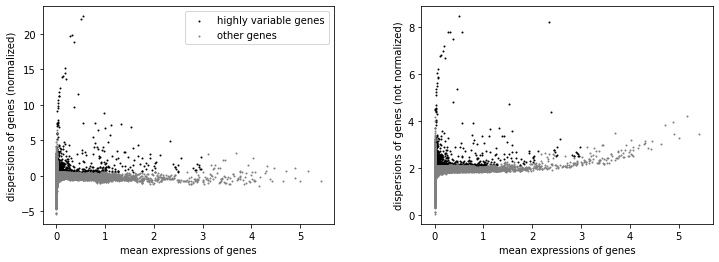

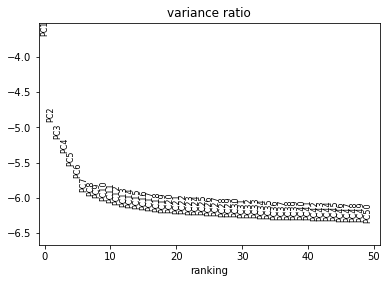

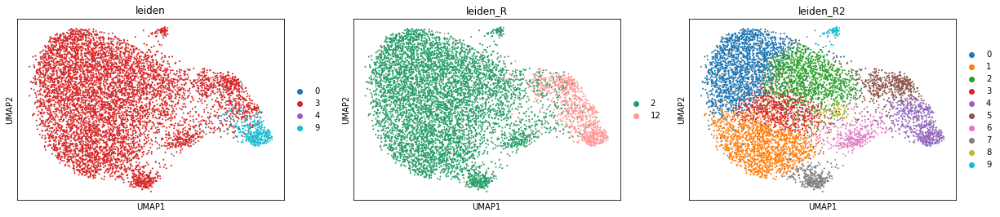

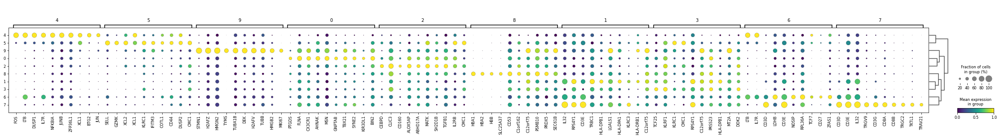

In [41]:
# subset to NK
adatax_nk = rna_x[rna_x.obs['leiden_R'].isin(['2', '12'])]
adatax_nk = adatax_nk.raw.to_adata()
adatax_nk.raw = adatax_nk
sc.pp.highly_variable_genes(adatax_nk, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(adatax_nk)
# subset to highly variable
adatax_nk = adatax_nk[:, adatax_nk.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(adatax_nk, ['n_counts', 'percent_mito'])
sc.pp.scale(adatax_nk, max_value = 10)
# Principal component analysis
sc.tl.pca(adatax_nk, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(adatax_nk, log = True, n_pcs = 50)
# run BBKNN
sc.external.pp.bbknn(adatax_nk, batch_key = 'patient')
# UMAP
sc.tl.umap(adatax_nk, n_components = 2, min_dist = 0.3)
sc.tl.leiden(adatax_nk, resolution = 1, key_added = 'leiden_R2')
sc.pl.umap(adatax_nk, color=['leiden', 'leiden_R', 'leiden_R2'])
sc.tl.rank_genes_groups(adatax_nk, groupby = 'leiden_R2', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(adatax_nk, min_fold_change=1)
sc.pl.rank_genes_groups_dotplot(adatax_nk, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

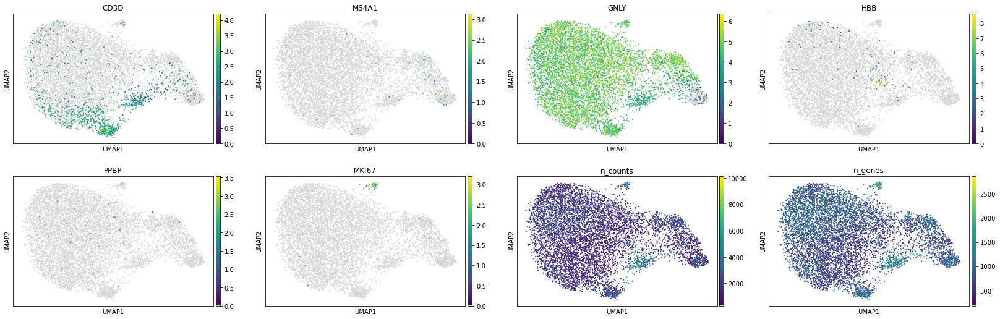

In [49]:
sc.pl.umap(adatax_nk, color=['CD3D', 'MS4A1', 'GNLY', 'HBB', 'PPBP', 'MKI67', 'n_counts', 'n_genes'], color_map = newcmp)

... storing 'temp_label' as categorical


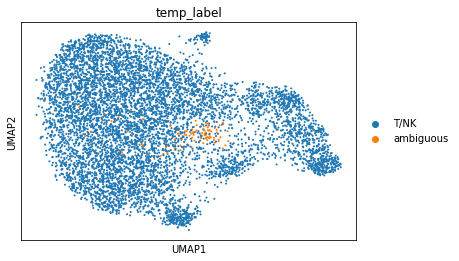

In [66]:
# ok only ambiguous cells found in 'NK' subgroup, flag them
new_dict = {'0':'T/NK',
'1':'T/NK',
'2':'T/NK',
'3':'T/NK',
'4':'T/NK',
'5':'T/NK',
'6':'T/NK',
'7':'T/NK',
'8':'ambiguous',
'9':'T/NK'}
adatax_nk.obs['temp_label'] = [new_dict[l] for l in adatax_nk.obs['leiden_R2']]
sc.pl.umap(adatax_nk, color = 'temp_label')

In [67]:
rna_x.obs['temp_label'] = pd.Series(adatax_nk.obs['temp_label'].append(adatax_cd8.obs['temp_label']).append(adatax_cd4.obs['temp_label']))

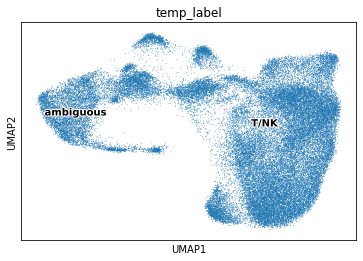

In [69]:
sc.pl.umap(rna_x, color=['temp_label'], legend_loc ='on data', legend_fontoutline=2)

... storing 'temp_label' as categorical


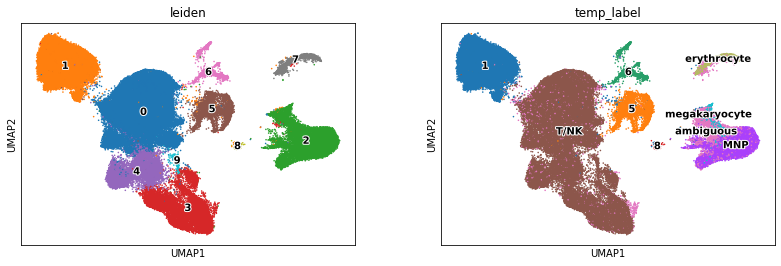

In [70]:
# update the original object
adata.obs['temp_label'] = adata.obs['temp_label'].astype('object')
adata.obs['temp_label'].update(rna_x.obs['temp_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'temp_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### pDC

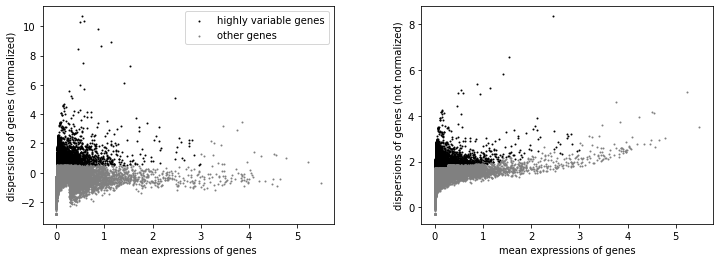

AnnData object with n_obs × n_vars = 421 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap'
    obsm: 'X_pca', 'X_umap'

In [71]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['8'])]
rna_x = rna_.raw.to_adata()
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [72]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

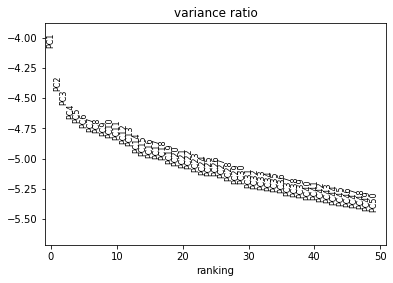

In [73]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

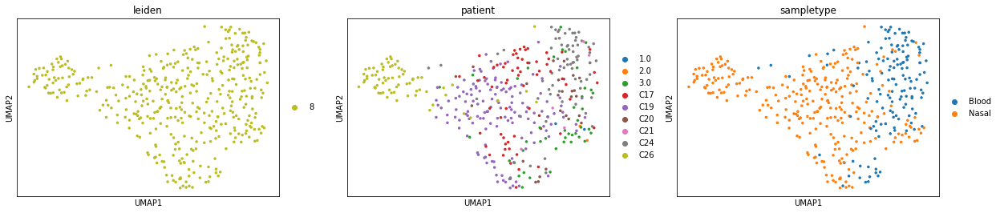

In [74]:
# run BBKNN
# sc.external.pp.bbknn(rna_x, batch_key = 'patient')
sc.pp.neighbors(rna_x)
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'], size=50)

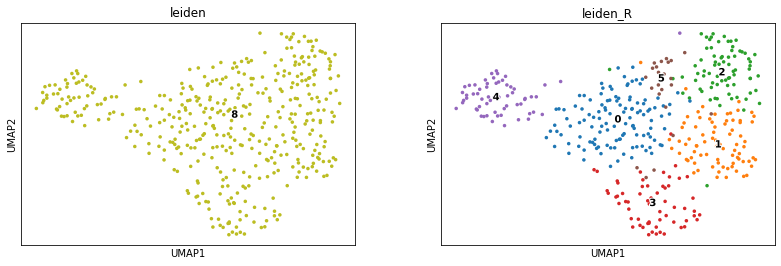

In [75]:
# find clusters
sc.tl.leiden(rna_x, resolution = 1, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=50, legend_loc ='on data', legend_fontoutline=2)

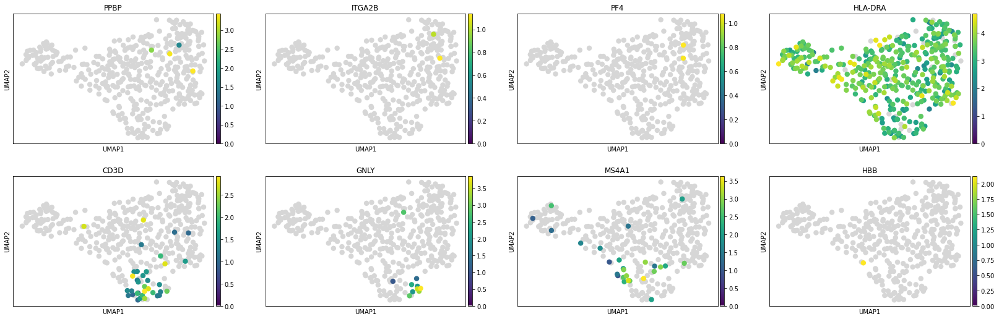

In [76]:
sc.pl.umap(rna_x, color = ['PPBP', 'ITGA2B', 'PF4', 'HLA-DRA', 'CD3D', 'GNLY', 'MS4A1', 'HBB'], color_map = newcmp)

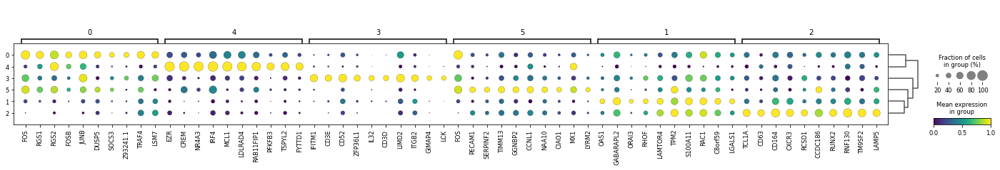

In [77]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'temp_label' as categorical


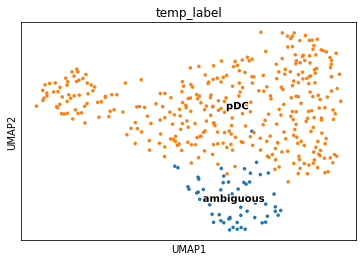

In [78]:
new_dict1 = {'0':'pDC',
'1':'pDC',
'2':'pDC',
'3':'ambiguous',
'4':'pDC',
'5':'pDC'}
rna_x.obs['temp_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['temp_label'], size=50, legend_loc ='on data', legend_fontoutline=2)

... storing 'temp_label' as categorical


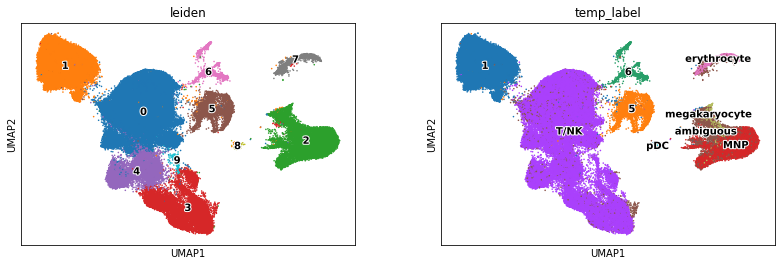

In [79]:
# update the original object
adata.obs['temp_label'] = adata.obs['temp_label'].astype('object')
adata.obs['temp_label'].update(rna_x.obs['temp_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'temp_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [92]:
# save the file temporarily
adata_raw.obs = adata.obs.copy() 
adata.write('out/adata_combined_v2.h5ad', compression = 'gzip')
adata_raw.write('out/adata_combined_raw_v2.h5ad', compression = 'gzip')

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import dandelion as ddl
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.logging.print_versions()

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/NC_study/scanpy'))

# create a palette for umap
import sys
sys.path.append('/home/jovyan/NC_study/scanpy/scripts')
from tools import cmp
newcmp = cmp()

scanpy==1.5.1 anndata==0.7.4 umap==0.4.6 numpy==1.19.1 scipy==1.5.2 pandas==1.0.5 scikit-learn==0.23.1 statsmodels==0.11.1 python-igraph==0.8.2 leidenalg==0.8.1


In [2]:
adata = sc.read_h5ad('out/adata_combined_v2.h5ad')
adata_raw = sc.read_h5ad('out/adata_combined_raw_v2.h5ad')

### B cells

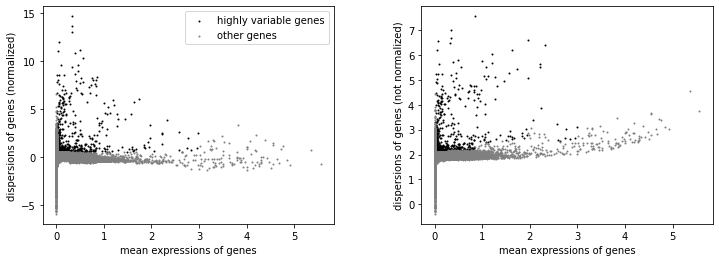

AnnData object with n_obs × n_vars = 19553 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap'
    obsm: 'X_pca', 'X_umap'

In [3]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['1'])]
rna_x = rna_.raw.to_adata()
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [4]:
# ## remove IGHV/IGLV/IGKV D and J genes from the highly variable genes
# import re
# for i in rna_x.var.index:
#     if re.search('^IG[HKL][VDJ]', i):
#         rna_x.var.at[i, 'highly_variable'] = False
# sc.pl.highly_variable_genes(rna_x)

In [5]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

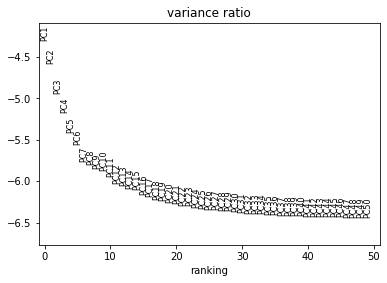

In [6]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

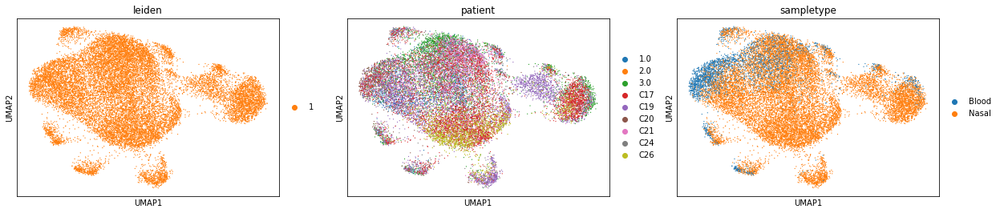

In [7]:
# # run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient')
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'])

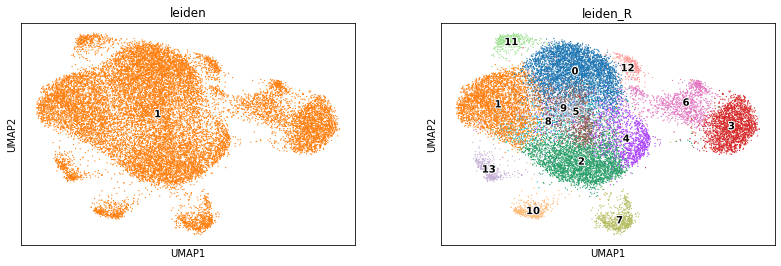

In [8]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], legend_loc ='on data', legend_fontoutline=2)

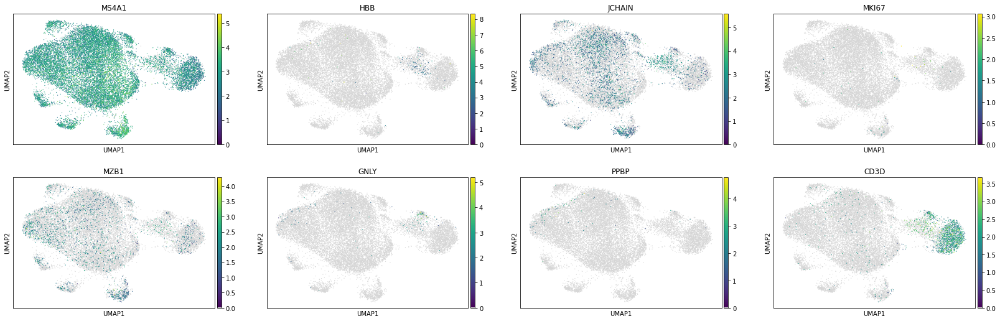

In [9]:
sc.pl.umap(rna_x, color = ['MS4A1', 'HBB', 'JCHAIN', 'MKI67', 'MZB1', 'GNLY', 'PPBP', 'CD3D'], color_map = newcmp)

In [10]:
import time
start_time = time.time()
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
print("--- %s seconds ---" % (time.time() - start_time))

--- 48.635289907455444 seconds ---


In [11]:
start_time = time.time()
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
print("--- %s seconds ---" % (time.time() - start_time))

--- 1.5292952060699463 seconds ---


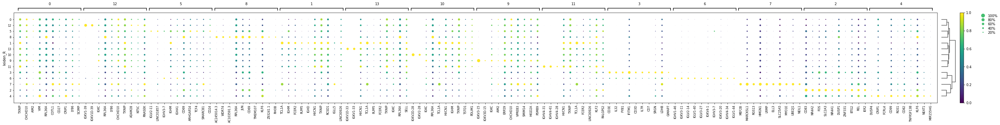

In [12]:
# sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R')
# sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'temp_label' as categorical


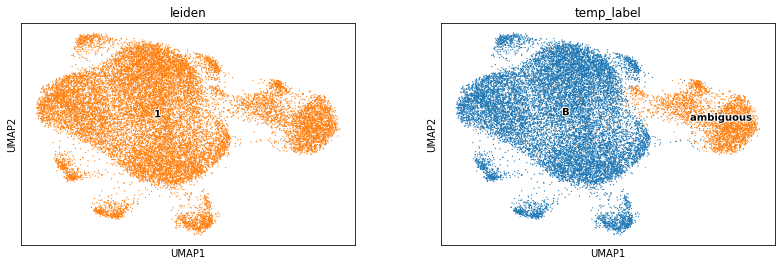

In [13]:
new_dict1 = {
'0':'B',
'1':'B',
'2':'B',
'3':'ambiguous',
'4':'B',
'5':'B',
'6':'ambiguous',
'7':'B',
'8':'B',
'9':'B',
'10':'B',
'11':'B',
'12':'B',
'13':'B'
}
rna_x.obs['temp_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['leiden', 'temp_label'], legend_loc ='on data', legend_fontoutline=2)

... storing 'temp_label' as categorical


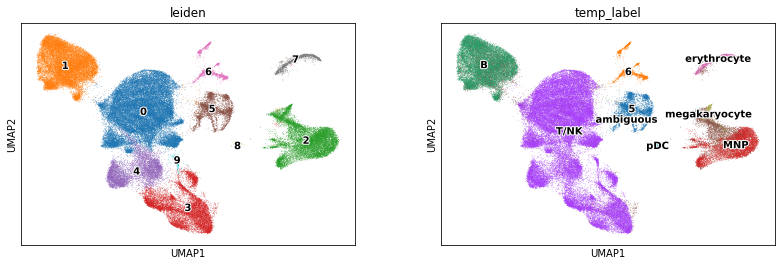

In [14]:
# update the original object
adata.obs['temp_label'] = adata.obs['temp_label'].astype('object')
adata.obs['temp_label'].update(rna_x.obs['temp_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'temp_label'], legend_loc = 'on data', legend_fontoutline=2)

### plasma cells

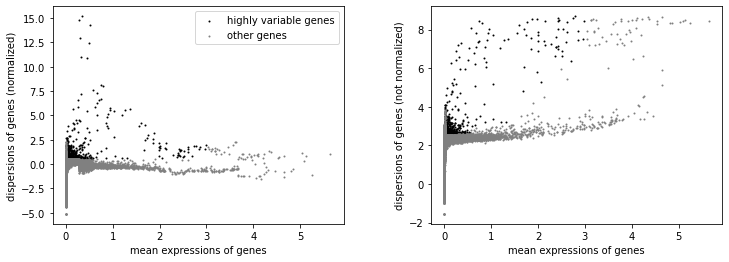

AnnData object with n_obs × n_vars = 4556 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap'
    obsm: 'X_pca', 'X_umap'

In [34]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['5'])]
rna_x = rna_.raw.to_adata()
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

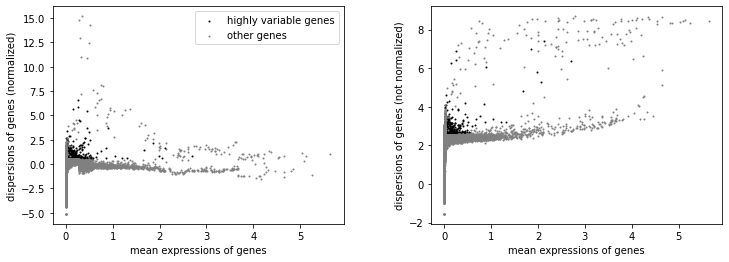

In [35]:
## remove IGHV/IGLV/IGKV D and J genes from the highly variable genes
import re
for i in rna_x.var.index:
    if re.search('^IG[HKL][VDJ]', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)

In [36]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

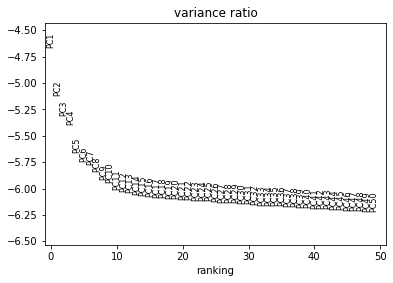

In [37]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

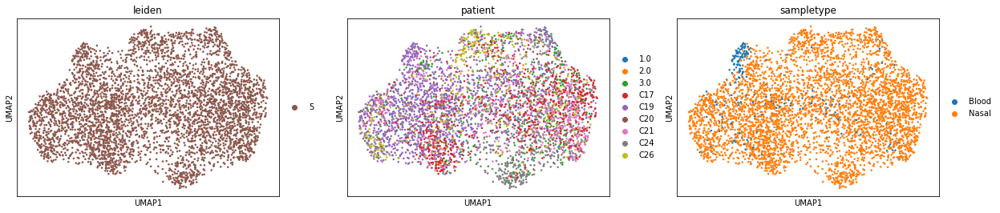

In [38]:
# # run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient')
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'])

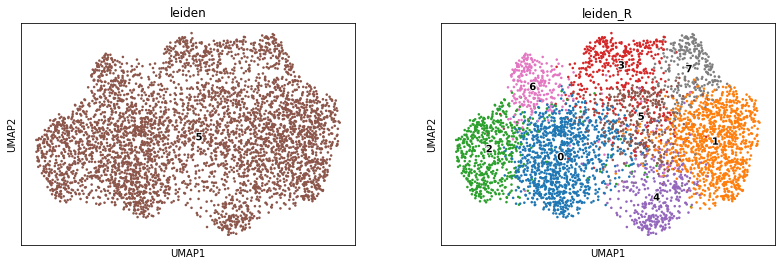

In [39]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R', resolution = 1)
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], legend_loc ='on data', legend_fontoutline=2)

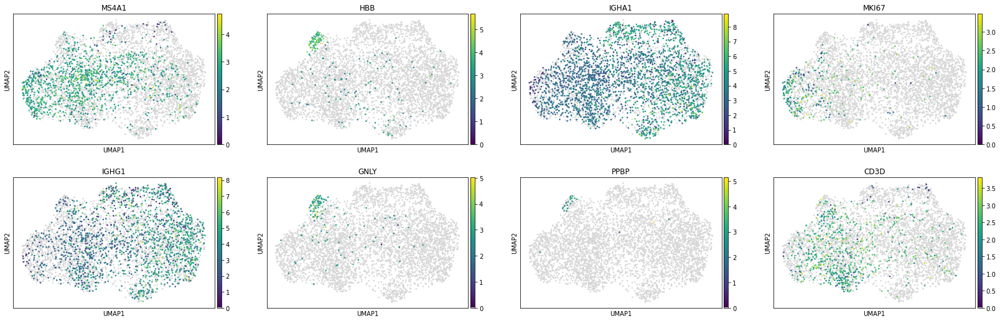

In [43]:
sc.pl.umap(rna_x, color = ['MS4A1', 'HBB', 'IGHA1', 'MKI67', 'IGHG1', 'GNLY', 'PPBP', 'CD3D'], color_map = newcmp)

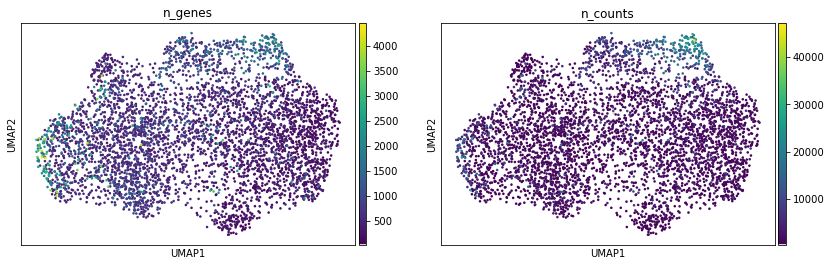

In [44]:
sc.pl.umap(rna_x, color = ['n_genes', 'n_counts'], color_map = newcmp)

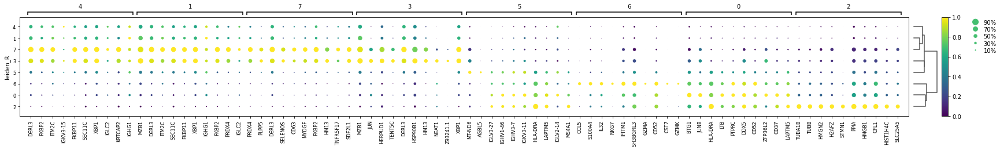

In [41]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'temp_label' as categorical


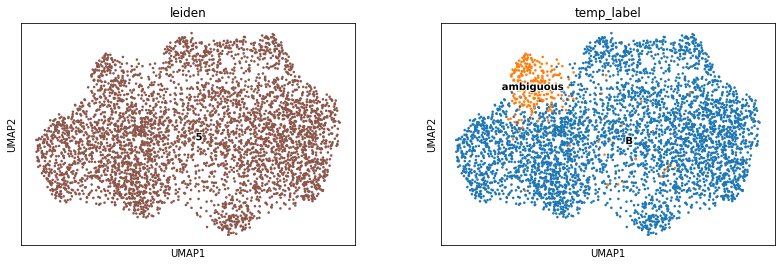

In [45]:
new_dict1 = {
'0':'B',
'1':'B',
'2':'B',
'3':'B',
'4':'B',
'5':'B',
'6':'ambiguous',
'7':'B'
}
rna_x.obs['temp_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['leiden', 'temp_label'], legend_loc ='on data', legend_fontoutline=2)

... storing 'temp_label' as categorical


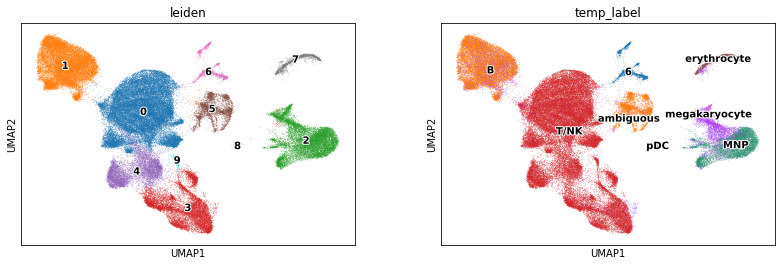

In [46]:
# update the original object
adata.obs['temp_label'] = adata.obs['temp_label'].astype('object')
adata.obs['temp_label'].update(rna_x.obs['temp_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'temp_label'], legend_loc = 'on data', legend_fontoutline=2)

### B and plasma cells round 2

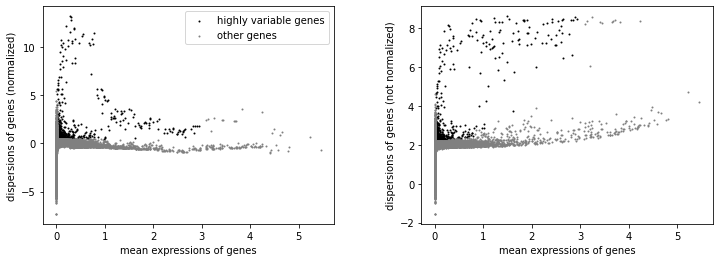

AnnData object with n_obs × n_vars = 20586 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap'
    obsm: 'X_pca', 'X_umap'

In [47]:
# subset
rna_ = adata[adata.obs['temp_label'].isin(['B'])]
rna_x = rna_.raw.to_adata()
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [49]:
# ## remove IGHV/IGLV/IGKV D and J genes from the highly variable genes
# import re
# for i in rna_x.var.index:
#     if re.search('^IG[HKL][VDJ]', i):
#         rna_x.var.at[i, 'highly_variable'] = False
# sc.pl.highly_variable_genes(rna_x)

In [48]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

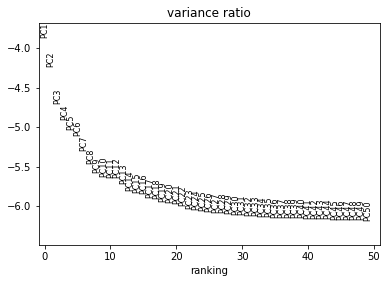

In [50]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

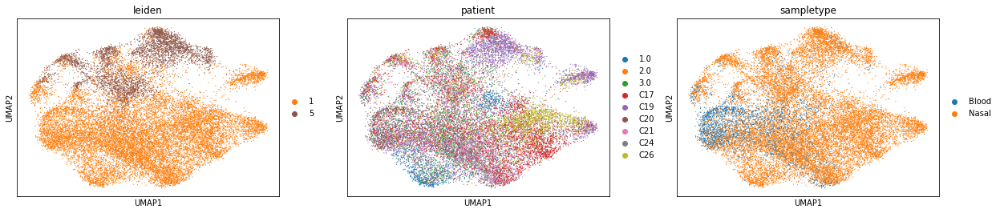

In [51]:
# # run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient')
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'])

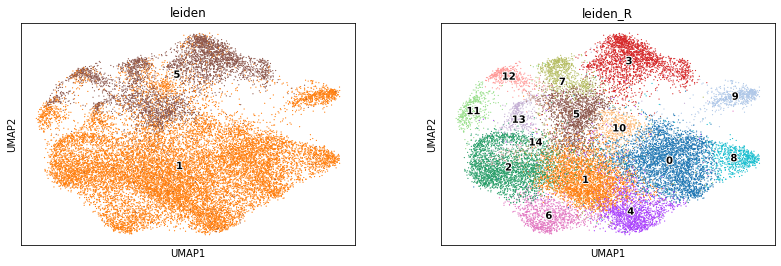

In [52]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R', resolution = 1)
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], legend_loc ='on data', legend_fontoutline=2)

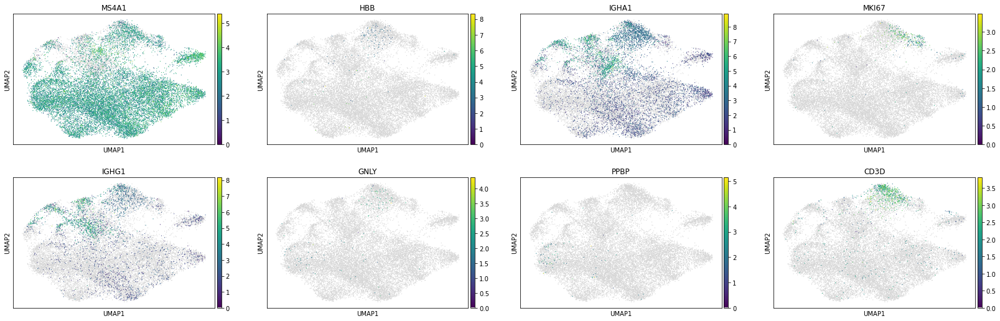

In [53]:
sc.pl.umap(rna_x, color = ['MS4A1', 'HBB', 'IGHA1', 'MKI67', 'IGHG1', 'GNLY', 'PPBP', 'CD3D'], color_map = newcmp)

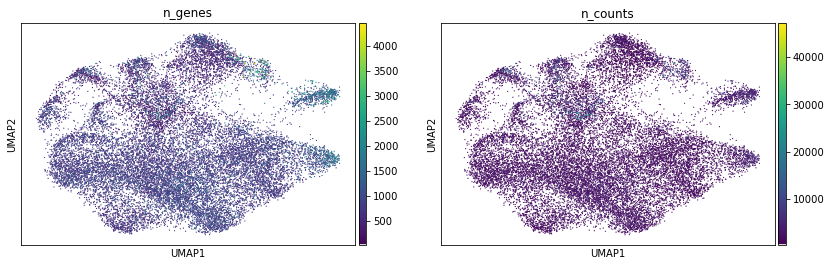

In [54]:
sc.pl.umap(rna_x, color = ['n_genes', 'n_counts'], color_map = newcmp)

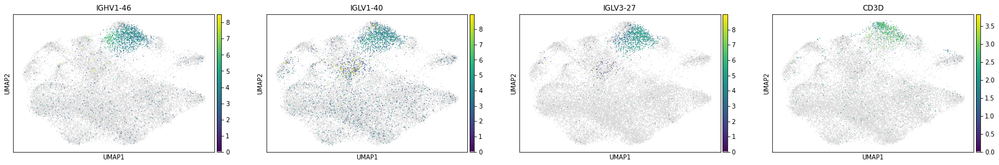

In [58]:
sc.pl.umap(rna_x, color = ['IGHV1-46', 'IGLV1-40', 'IGLV3-27', 'CD3D'], color_map = newcmp)

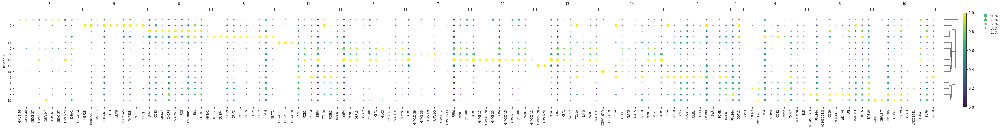

In [59]:
# sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
# sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
# sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'temp_label' as categorical


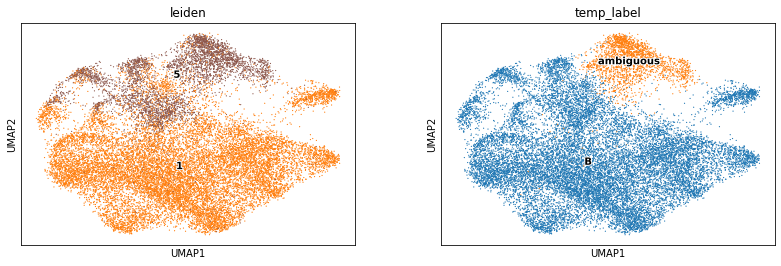

In [60]:
new_dict1 = {
'0':'B',
'1':'B',
'2':'B',
'3':'ambiguous',
'4':'B',
'5':'B',
'6':'B',
'7':'B',
'8':'B',
'9':'B',
'10':'B',
'11':'B',
'12':'B',
'13':'B',
'14':'B'
}
rna_x.obs['temp_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['leiden', 'temp_label'], legend_loc ='on data', legend_fontoutline=2)

... storing 'temp_label' as categorical


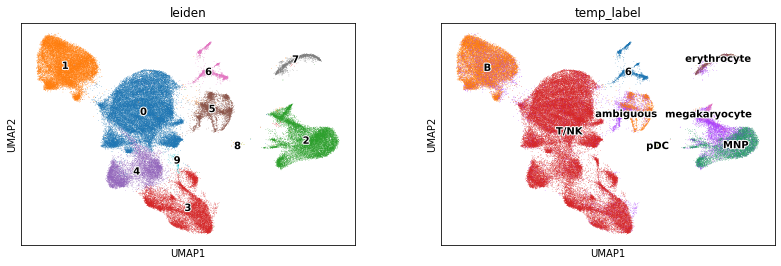

In [61]:
# update the original object
adata.obs['temp_label'] = adata.obs['temp_label'].astype('object')
adata.obs['temp_label'].update(rna_x.obs['temp_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'temp_label'], legend_loc = 'on data', legend_fontoutline=2)

### Others

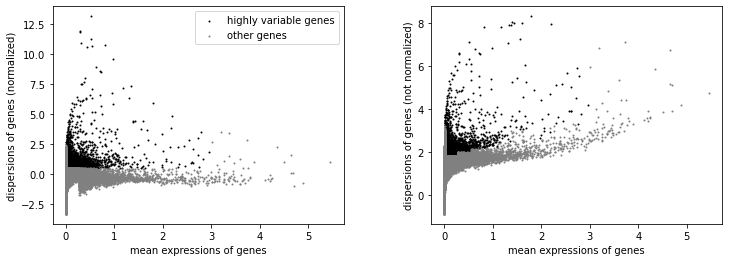

AnnData object with n_obs × n_vars = 2060 × 22498
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'umap'
    obsm: 'X_pca', 'X_umap'

In [62]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['6'])]
rna_x = rna_.raw.to_adata()
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

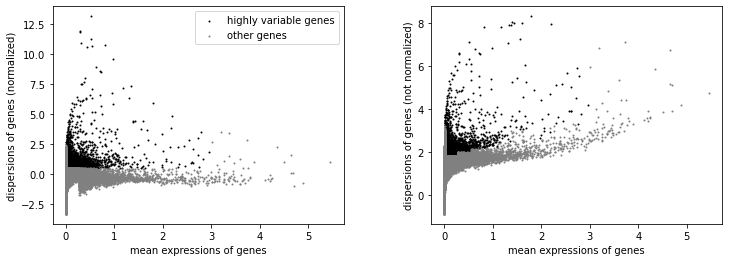

In [63]:
sc.pl.highly_variable_genes(rna_x)

In [64]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

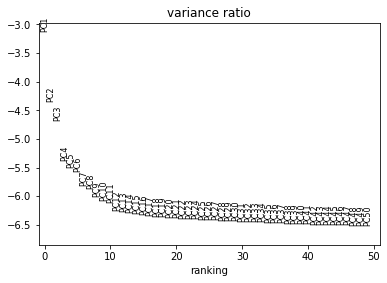

In [65]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

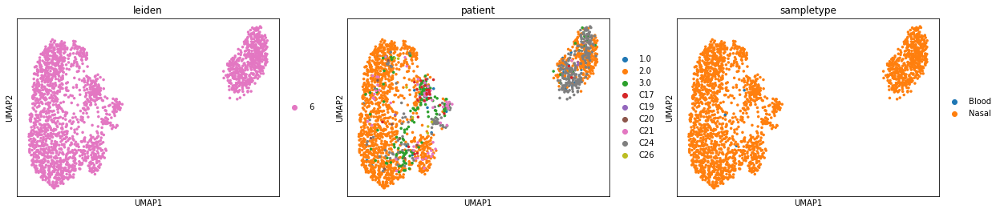

In [66]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient')
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'], size=50)

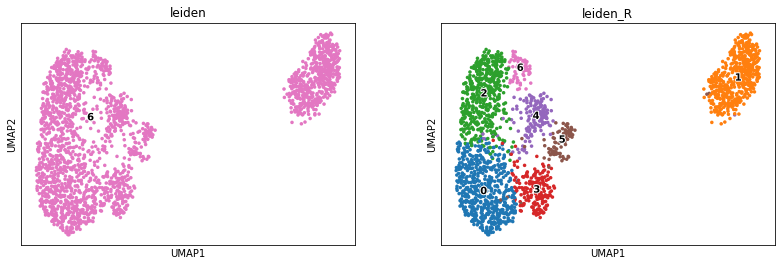

In [67]:
# find clusters
sc.tl.leiden(rna_x, resolution = 1, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=50, legend_loc ='on data', legend_fontoutline=2)

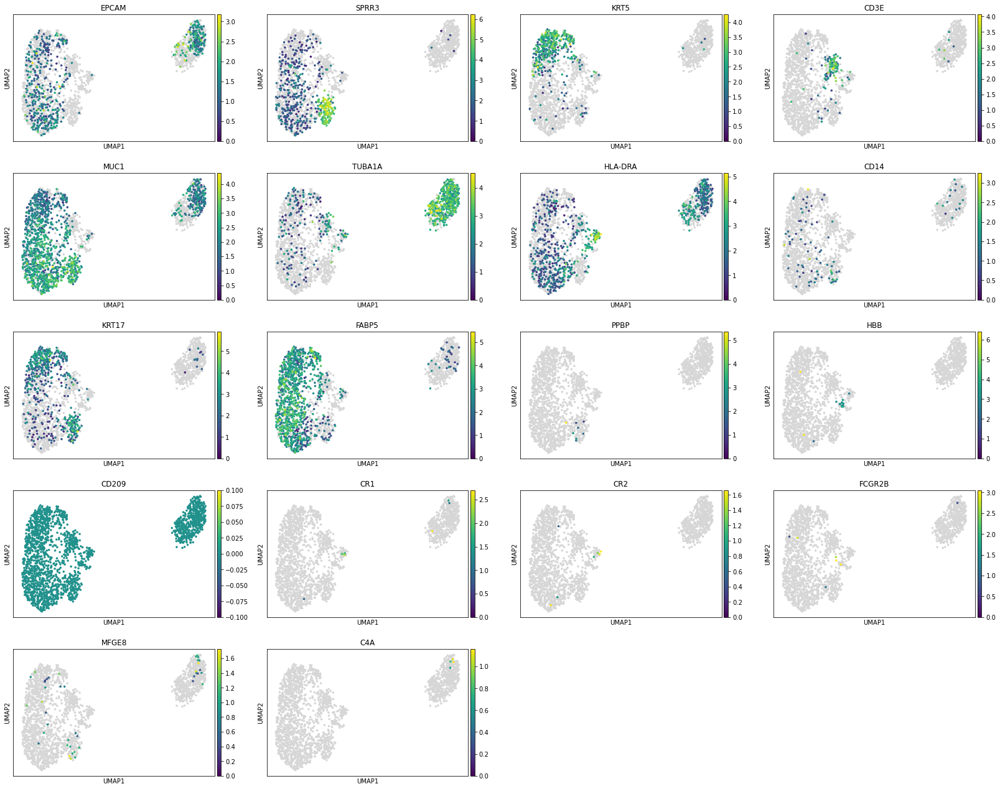

In [75]:
sc.pl.umap(rna_x, color = ['EPCAM', 'SPRR3', 'KRT5', 'CD3E', 'MUC1', 'TUBA1A', 'HLA-DRA', 'CD14', 'KRT17', 'FABP5', 'PPBP', 'HBB', 'CD209', 'CR1', 'CR2', 'FCGR2B', 'MFGE8', 'C4A'], color_map = newcmp, size = 50)


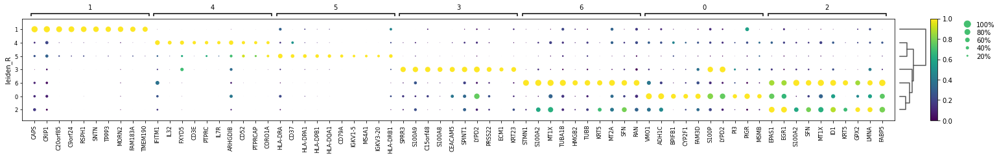

In [69]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'temp_label' as categorical


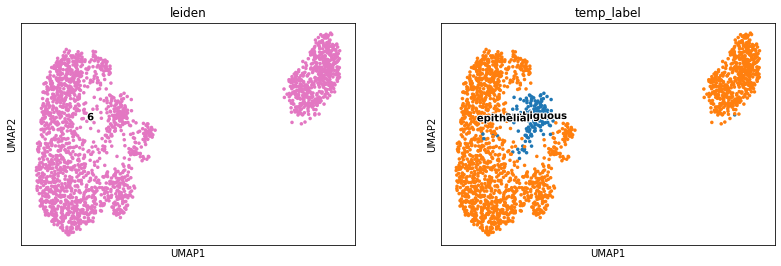

In [76]:
new_dict1 = {'0':'epithelial',
'1':'epithelial',
'2':'epithelial',
'3':'epithelial',
'4':'ambiguous',
'5':'epithelial',
'6':'epithelial'}
rna_x.obs['temp_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['leiden', 'temp_label'], size=50, legend_loc ='on data', legend_fontoutline=2)

... storing 'temp_label' as categorical


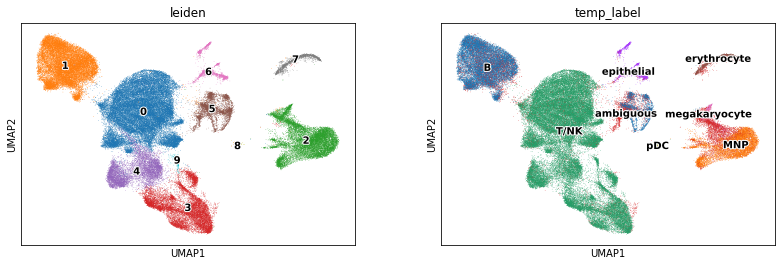

In [77]:
# update the original object
adata.obs['temp_label'] = adata.obs['temp_label'].astype('object')
adata.obs['temp_label'].update(rna_x.obs['temp_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'temp_label'], legend_loc = 'on data', legend_fontoutline=2)

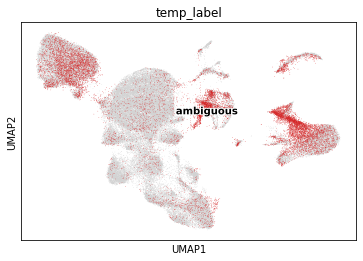

In [80]:
sc.pl.umap(adata, color = ['temp_label'], groups = 'ambiguous', legend_loc = 'on data', legend_fontoutline=2)

In [79]:
# save the file temporarily
adata_raw.obs = adata.obs.copy() 
adata.write('out/adata_combined_v2.h5ad', compression = 'gzip')
adata_raw.write('out/adata_combined_raw_v2.h5ad', compression = 'gzip')

In [82]:
adata

AnnData object with n_obs × n_vars = 93971 × 876
    obs: 'sampleid', 'patient', 'sampletype', 'age_group', 'gender', 'cohort', 'batch', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'leiden', 'temp_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'pca', 'sampleid_colors', 'sampletype_colors', 'temp_label_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [81]:
adata.obs['temp_label'].value_counts()

T/NK             50610
B                18352
ambiguous        13098
MNP               7587
epithelial        1899
erythrocyte       1356
megakaryocyte      710
pDC                359
Name: temp_label, dtype: int64

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import dandelion as ddl
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.logging.print_versions()

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/NC_study/scanpy'))

# create a palette for umap
import sys
sys.path.append('/home/jovyan/NC_study/scanpy/scripts')
from tools import cmp
newcmp = cmp()

scanpy==1.5.1 anndata==0.7.4 umap==0.4.6 numpy==1.19.1 scipy==1.5.2 pandas==1.0.5 scikit-learn==0.23.1 statsmodels==0.11.1 python-igraph==0.8.2 leidenalg==0.8.1


In [2]:
adata = sc.read_h5ad('out/adata_combined_v2.h5ad')
adata_raw = sc.read_h5ad('out/adata_combined_raw_v2.h5ad')